In [122]:
import sys
import gc
import os
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np
import scvi
import plotnine as p9 
import networkx as nx
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import pdist

sys.path.append('TS_DEG_method/')
import utils,figure_all

In [106]:
%load_ext autoreload
%autoreload 2
#%reload_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
edgeR_LRT_all = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/edgeR_LRT_all_DEGs.csv',index_col=0)
edgeR_LRT_all.index = edgeR_LRT_all['gene_symbol'].values

edgeR_LRT_all_tissue = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/edgeR_LRT_all_DEGs_tissue.csv',index_col=0)
edgeR_LRT_all_tissue.index = edgeR_LRT_all_tissue['gene_symbol'].values


In [4]:
gtf = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/gencode.v41.annotation.gtf', comment='#', sep='\t', header=None)
gtf_columns = ['seqname', 'source', 'feature', 'start', 'end', 'score', 'strand', 'frame', 'attribute']
gtf.columns = gtf_columns

# Extract gene name and gene type from the attributes column
gtf['gene_name'] = gtf['attribute'].str.extract('gene_name "([^"]+)"')
gtf['gene_type'] = gtf['attribute'].str.extract('gene_type "([^"]+)"')
gtf['chr'] = gtf['seqname']

gene_info_mapping = gtf[['gene_name', 'chr', 'gene_type']].drop_duplicates().set_index('gene_name')



In [5]:
chromosome_classification = {
    'chrY': 'chrY',
    'chrX': 'chrX',
    'chr16': 'autosomal',
    'chr20': 'autosomal',
    'chr1': 'autosomal',
    'chr8': 'autosomal',
    'chr6': 'autosomal',
    'chr9': 'autosomal',
    'chr10': 'autosomal',
    'chr18': 'autosomal',
    'chr14': 'autosomal',
    'chr22': 'autosomal',
    'chr2': 'autosomal',
    'chr21': 'autosomal',
    'chr12': 'autosomal',
    'chr5': 'autosomal',
    'chr19': 'autosomal',
    'chr3': 'autosomal',
    'chrM': 'chrM',
    'chr17': 'autosomal',
    'chr15': 'autosomal',
    'chr4': 'autosomal',
    'chr7': 'autosomal',
    'chr11': 'autosomal',
    'chr13': 'autosomal',
    np.nan: 'nan'
}

In [6]:
gene_type_classification = {
    'chrY_protein_coding': 'chrY',
    'chrY_transcribed_unitary_pseudogene': 'chrY',
    'chrX_lncRNA': 'chrX',
    'chrY_transcribed_unprocessed_pseudogene': 'chrY',
    'chrY_lncRNA': 'chrY',
    'chrX_protein_coding': 'chrX',
    'autosomal_protein_coding': 'Autosomal-coding',
    'autosomal_processed_pseudogene': 'Autosomal-noncoding',
    'autosomal_lncRNA': 'Autosomal-noncoding',
    'chrY_unprocessed_pseudogene': 'chrY',
    'chrM_protein_coding': 'MT-mt',
    'chrY_processed_pseudogene': 'chrY',
    'autosomal_transcribed_unprocessed_pseudogene': 'Autosomal-noncoding',
    'chrX_transcribed_processed_pseudogene': 'chrX',
    'autosomal_TR_C_gene': 'Autosomal-coding',
    'chrX_processed_pseudogene': 'chrX',
    'chrM_Mt_rRNA': 'MT-mt',
    'autosomal_transcribed_unitary_pseudogene': 'Autosomal-noncoding',
    'chrX_unprocessed_pseudogene': 'chrX',
    'autosomal_transcribed_processed_pseudogene': 'Autosomal-noncoding',
    'chrX_transcribed_unprocessed_pseudogene': 'chrX',
    'autosomal_misc_RNA': 'Autosomal-noncoding',
    'chrY_transcribed_processed_pseudogene': 'chrY',
    'autosomal_unprocessed_pseudogene': 'Autosomal-noncoding',
    'chrM_Mt_tRNA': 'MT-mt',
    'autosomal_TEC': 'Autosomal-noncoding',
    'chrX_transcribed_unitary_pseudogene': 'chrX',
    'chrX_misc_RNA': 'chrX',
    'chrX_snRNA': 'chrX',
    'chrY_misc_RNA': 'chrY',
    'chrX_snoRNA': 'chrX',
    'chrX_TEC': 'chrX',
    'chrX_pseudogene': 'chrX',
    'chrX_miRNA': 'chrX',
    'chrX_unitary_pseudogene': 'chrX',
    np.nan: 'nan',
    'autosomal_snoRNA': 'Autosomal-noncoding',
    'autosomal_TR_V_gene': 'Autosomal-coding',
    'autosomal_IG_C_gene': 'Autosomal-coding',
    'chrY_rRNA_pseudogene': 'chrY',
    'autosomal_scRNA': 'Autosomal-noncoding',
    'chrX_rRNA_pseudogene': 'chrX',
    'autosomal_snRNA': 'Autosomal-noncoding'
}


gene_type_coding_classification = {
    'chrY_protein_coding': 'coding',
    'chrY_transcribed_unitary_pseudogene': 'non-coding',
    'chrX_lncRNA': 'non-coding',
    'chrY_transcribed_unprocessed_pseudogene': 'non-coding',
    'chrY_lncRNA': 'non-coding',
    'chrX_protein_coding': 'coding',
    'autosomal_protein_coding': 'coding',
    'autosomal_processed_pseudogene': 'non-coding',
    'autosomal_lncRNA': 'non-coding',
    'chrY_unprocessed_pseudogene': 'non-coding',
    'chrM_protein_coding': 'coding',
    'chrY_processed_pseudogene': 'non-coding',
    'autosomal_transcribed_unprocessed_pseudogene': 'non-coding',
    'chrX_transcribed_processed_pseudogene': 'non-coding',
    'autosomal_TR_C_gene': 'coding',
    'chrX_processed_pseudogene': 'non-coding',
    'chrM_Mt_rRNA': 'non-coding',
    'autosomal_transcribed_unitary_pseudogene': 'non-coding',
    'chrX_unprocessed_pseudogene': 'non-coding',
    'autosomal_transcribed_processed_pseudogene': 'non-coding',
    'chrX_transcribed_unprocessed_pseudogene': 'non-coding',
    'autosomal_misc_RNA': 'non-coding',
    'chrY_transcribed_processed_pseudogene': 'non-coding',
    'autosomal_unprocessed_pseudogene': 'non-coding',
    'chrM_Mt_tRNA': 'non-coding',
    'autosomal_TEC': 'non-coding',
    'chrX_transcribed_unitary_pseudogene': 'non-coding',
    'chrX_misc_RNA': 'non-coding',
    'chrX_snRNA': 'non-coding',
    'chrY_misc_RNA': 'non-coding',
    'chrX_snoRNA': 'non-coding',
    'chrX_TEC': 'non-coding',
    'chrX_pseudogene': 'non-coding',
    'chrX_miRNA': 'non-coding',
    'chrX_unitary_pseudogene': 'non-coding',
    'nan': 'nan',
    'autosomal_snoRNA': 'non-coding',
    'autosomal_TR_V_gene': 'coding',
    'autosomal_IG_C_gene': 'coding',
    'chrY_rRNA_pseudogene': 'non-coding',
    'autosomal_scRNA': 'non-coding',
    'chrX_rRNA_pseudogene': 'non-coding',
    'autosomal_snRNA': 'non-coding'
}


In [7]:
# Map gene information to DEG data
edgeR_LRT_all = edgeR_LRT_all.join(gene_info_mapping, on='gene_symbol')
edgeR_LRT_all['chr_new'] = edgeR_LRT_all['chr'].map(chromosome_classification)

edgeR_LRT_all['chr_gene_type'] = edgeR_LRT_all['chr_new']+'_'+edgeR_LRT_all['gene_type']

edgeR_LRT_all['type_new'] = edgeR_LRT_all['chr_gene_type'].map(gene_type_classification)
edgeR_LRT_all['coding'] = edgeR_LRT_all['chr_gene_type'].map(gene_type_coding_classification)




In [8]:
edgeR_LRT_all_tissue = edgeR_LRT_all_tissue.join(gene_info_mapping, on='gene_symbol')
edgeR_LRT_all_tissue['chr_new'] = edgeR_LRT_all_tissue['chr'].map(chromosome_classification)

edgeR_LRT_all_tissue['chr_gene_type'] = edgeR_LRT_all_tissue['chr_new']+'_'+edgeR_LRT_all_tissue['gene_type']

edgeR_LRT_all_tissue['type_new'] = edgeR_LRT_all_tissue['chr_gene_type'].map(gene_type_classification)
edgeR_LRT_all_tissue['coding'] = edgeR_LRT_all_tissue['chr_gene_type'].map(gene_type_coding_classification)



In [9]:
# List of known ribosomal gene prefixes
ribosomal_prefixes = ['RPS', 'RPL']

# Function to classify based on gene type and chromosome
def classify_gene(row):
    gene_name = row.name
    chr = row['chr_new']
    gene_type = row['type_new']
    
    #print(gene_type)
    if (gene_name.startswith(tuple(ribosomal_prefixes))) & (chr == 'autosomal'):
        return 'Autosomal-ribosomal'
    elif chr == 'chrY':
        return 'chrY'
    elif chr == 'chrX':
        return 'chrX'
    elif 'MT' in gene_type:
        return 'MT-mt'
    elif 'Autosomal-coding' in gene_type:
        return 'Autosomal-coding'
    elif 'Autosomal-noncoding' in gene_type:
        return 'Autosomal-noncoding'
    elif 'Autosomal-general' in gene_type:
        return 'Autosomal-generale'
    else:
        return 'nan'
        
    
edgeR_LRT_all['type_new2'] = edgeR_LRT_all.apply(classify_gene, axis=1)

edgeR_LRT_all_tissue['type_new2'] = edgeR_LRT_all_tissue.apply(classify_gene, axis=1)


In [10]:
TS_data_df = edgeR_LRT_all
TS_data_df_tissue = edgeR_LRT_all_tissue

TS_data_df = TS_data_df[TS_data_df.tissue!='Thymus'].copy()
TS_data_df_tissue = TS_data_df_tissue[TS_data_df_tissue.tissue!='Thymus'].copy()

In [11]:
TS_data_df = TS_data_df[TS_data_df['FDR']<0.001  ]
TS_data_df_tissue = TS_data_df_tissue[TS_data_df_tissue['FDR']<0.001]

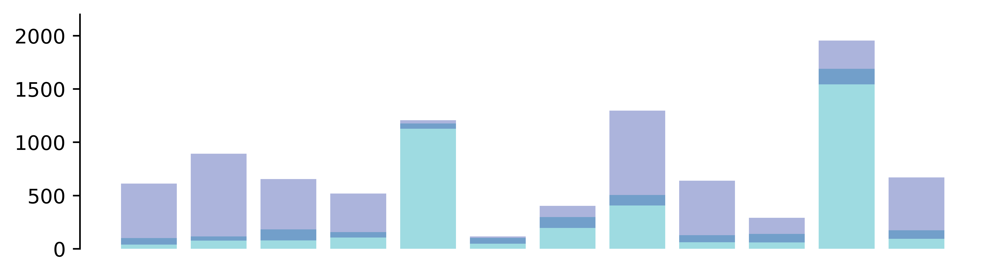

,Tissue,DE identified in tissue,DE identified in ct_tissue,Overlapped DE between tissue and ct_tissue,percent in tissue,percent in ct_tissue
0,Bladder,100,573,61,61.000000,10.645724
1,Blood,115,815,38,33.043478,4.662577
2,Bone_Marrow,181,576,103,56.906077,17.881944
3,Fat,157,413,52,33.121019,12.590799
4,Heart,1175,80,49,4.170213,61.250000
5,Lymph_Node,102,67,54,52.941176,80.597015
6,Muscle,298,208,103,34.563758,49.519231
7,Salivary_Gland,504,890,98,19.444444,11.011236
8,Spleen,128,578,67,52.343750,11.591696
9,Tongue,139,231,79,56.834532,34.199134


In [12]:
figure_all.plot_figure1a(TS_data_df,TS_data_df_tissue)

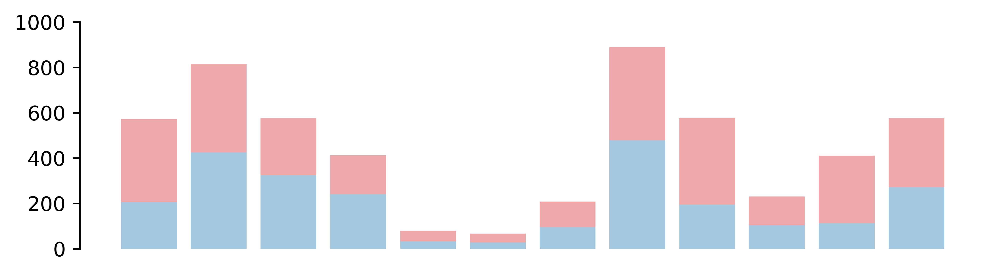

In [13]:
count_DE_number = figure_all.plot_figure1b(TS_data_df)

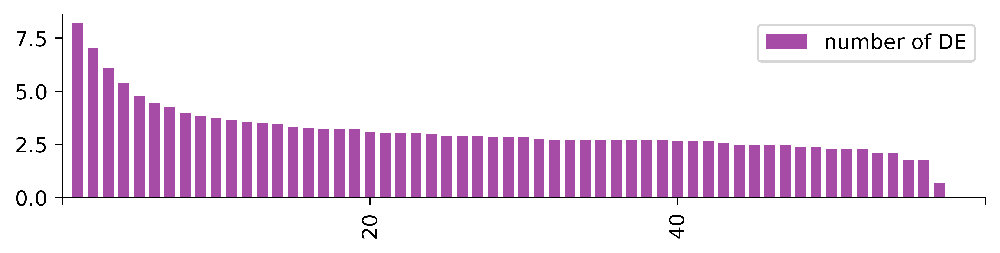

In [14]:
nDE_share_across_cell_tissue,num_count = figure_all.plot_figure2(TS_data_df)


In [15]:
nDE_share_across_cell_tissue

,gene_symbol,number
3598,PSMA3,1
3599,TMEM255B,1
3600,ELN,1
3601,F8,1
3602,IFIT1,1
...,...,...
2,XIST,56
3,UTY,56
13,LINC00278,56
1,RPS4Y1,57


In [16]:
nDE_share_across_cell_tissue[nDE_share_across_cell_tissue.number>30]

,gene_symbol,number
17,ZFY-AS1,31
10,ZFY,39
71,ANOS2P,42
82,TTTY10,43
15,TSIX,47
11,TTTY14,49
8,KDM5D,52
4,USP9Y,52
5,PRKY,54
6,TXLNGY,54


In [17]:
df_ = TS_data_df[(TS_data_df['type_new2']=='Autosomal-coding')]

In [18]:
df_[df_.logFC>4.5]

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,chr_new,chr_gene_type,type_new,coding,type_new2,tissue_cell_type
LCN2,6.283700,10.051860,44.031232,3.231779e-11,1.213230e-08,LCN2,Bladder,transitional epithelial cell,4646,22017,2,4,chr9,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_transitional epithelial cell
FCER1G,4.599175,6.472815,33.600444,6.767728e-09,2.793944e-06,FCER1G,Bone_Marrow,stem cell,1040,728,3,3,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bone_Marrow_stem cell
PTGDS,5.035432,10.610583,35.966953,2.006926e-09,6.503158e-07,PTGDS,Salivary_Gland,fibroblast,2760,1435,2,2,chr9,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Salivary_Gland_fibroblast
DOCK5,4.508609,7.962395,30.994175,2.588040e-08,7.460210e-06,DOCK5,Trachea,fibroblast,1424,247,2,3,chr8,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Trachea_fibroblast


In [19]:
map_up,map_up_gene,map_down,map_down_gene= figure_all.plot_figure2d(TS_data_df,nDE_share_across_cell_tissue)

In [20]:
map_down

,1,2,3,4,5,6,7
0,1784,464,139,46,23,4,1
1,1131,254,78,28,10,1,1
2,265,22,6,3,2,1,0
3,39,3,1,0,0,0,0
4,9,0,0,0,0,0,0
5,1,0,0,0,0,0,0


In [21]:
map_down_gene

,1,2,3,4,5,6,7
0,"[H4C3, CEBPB, CRYBG1, TNFSF8, SRGN, TG, ID2, S...","[H4C3, CEBPB, ID2, SLC7A5, NDFIP1, TGFB1, ZFP3...","[H4C3, CEBPB, ZFP36L2, H1-2, MYH9, ZFP36, PRMT...","[H4C3, ZFP36L2, BTG1, SAMD1, CHPT1, PLIN2, RHO...","[ZFP36L2, BTG1, SAMD1, CHPT1, PDK4, BCL6, KCNE...","[ZFP36L2, MKNK2, HSPA1A, HSPD1]",[HSPA1A]
1,"[H4C3, CEBPB, CRYBG1, TNFSF8, TG, ID2, SLC7A5,...","[H4C3, CEBPB, ID2, SLC7A5, SOCS1, H1-2, CAPN13...","[H4C3, CEBPB, H1-2, SAMD1, CHPT1, PLIN2, CDKN1...","[H4C3, SAMD1, PLIN2, PDK4, ZFP36L2, CD55, KCNE...","[PDK4, ERN1, IFITM1, CSGALNACT1, HSPA1A, HSPA1...",[HSPA1A],[HSPA1A]
2,"[UPK2, DLGAP1, PFKFB3, ST3GAL1, RNF149, NAMPT,...","[SOD2, BASP1, ACSL1, SLC6A6, CSGALNACT1, ADGRB...","[CSGALNACT1, HSPA1A, DNAJB1, HSPH1, HSPD1, IFI...","[HSPA1A, DNAJB1, HSPH1]","[HSPA1A, DNAJB1]",[HSPA1A],[]
3,"[PFKFB3, RNF149, NAMPT, PTPRE, SOD2, USP32, CP...","[HSPA1A, HSPA1B, HSPH1]",[HSPH1],[],[],[],[]
4,"[PFKFB3, N4BP1, IVNS1ABP, ACSL1, HSPA1A, HSPH1...",[],[],[],[],[],[]
5,[SELENOH],[],[],[],[],[],[]


In [22]:
## 2
flattened_values = [item for sublist in map_up_gene.loc[:2,4:].values.flatten() for item in sublist]

TS_data_df[(TS_data_df['type_new2']=='Autosomal-coding')].loc[np.unique(flattened_values)][['logFC','FDR','tissue_cell_type']].to_csv('2.csv')
np.unique(flattened_values)

array(['ABCA5', 'ATP2B1', 'BID', 'BTN3A1', 'CIRBP', 'GPCPD1', 'GYPC',
       'HLA-DPB1', 'HLA-DRB1', 'NABP1', 'PPDPF', 'PSMB9', 'TC2N'],
      dtype='<U8')

In [23]:
## 2
flattened_values = [item for sublist in map_down_gene.loc[:2,5:].values.flatten() for item in sublist]

TS_data_df[(TS_data_df['type_new2']=='Autosomal-coding')].loc[np.unique(flattened_values)][['logFC','FDR','tissue_cell_type']].to_csv('2.csv')
np.unique(flattened_values)

array(['BCL6', 'BTG1', 'CD81', 'CHPT1', 'CSGALNACT1', 'CTBP1', 'DNAJB1',
       'ERN1', 'HSP90AA1', 'HSPA1A', 'HSPA1B', 'HSPD1', 'HSPH1', 'IFITM1',
       'JDP2', 'KCNE1', 'MKNK2', 'PABPN1', 'PDK4', 'SAMD1', 'SPTLC2',
       'TCIRG1', 'ZFP36L2'], dtype='<U10')

In [24]:
## 1
flattened_values = [item for sublist in map_up_gene.loc[4:,:2].values.flatten() for item in sublist]

TS_data_df[(TS_data_df['type_new2']=='Autosomal-coding')].loc[np.unique(flattened_values)][['logFC','FDR','tissue_cell_type']].to_csv('1.csv')
np.unique(flattened_values)

array(['CDKN2D', 'DOCK5', 'FCER1G', 'FOLR2', 'LCN2', 'PTGDS', 'RNASE1'],
      dtype='<U6')

In [25]:
## 1
flattened_values = [item for sublist in map_down_gene.loc[4:,:2].values.flatten() for item in sublist]

TS_data_df[(TS_data_df['type_new2']=='Autosomal-coding')].loc[np.unique(flattened_values)][['logFC','FDR','tissue_cell_type']].to_csv('1.csv')
np.unique(flattened_values)

array(['ACSL1', 'HSPA1A', 'HSPH1', 'IVNS1ABP', 'N4BP1', 'PFKFB3',
       'SELENOH', 'USP53', 'ZNF618'], dtype='<U8')

In [26]:
TS_data_df[TS_data_df.gene_symbol=='HSPA1A']

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,chr_new,chr_gene_type,type_new,coding,type_new2,tissue_cell_type
HSPA1A,2.447910,7.657799,25.363108,4.749142e-07,5.965485e-05,HSPA1A,Bladder,transitional epithelial cell,4646,22017,2,4,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_transitional epithelial cell
HSPA1A,-4.350244,9.487675,66.935546,2.805307e-16,2.043749e-13,HSPA1A,Bone_Marrow,stem cell,1040,728,3,3,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bone_Marrow_stem cell
HSPA1A,-2.320329,10.034308,26.396854,2.779930e-07,5.930952e-05,HSPA1A,Bone_Marrow,t cell,3468,1676,3,3,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bone_Marrow_t cell
HSPA1A,-2.954558,10.530548,53.191325,3.025922e-13,1.440339e-10,HSPA1A,Bone_Marrow,myeloid leukocyte,1187,1256,3,3,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bone_Marrow_myeloid leukocyte
HSPA1A,-2.591695,9.118860,27.927023,1.259780e-07,4.651981e-05,HSPA1A,Bone_Marrow,hematopoietic cell,1246,474,3,3,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bone_Marrow_hematopoietic cell
HSPA1A,-3.036987,10.018094,27.214285,1.821082e-07,8.976975e-05,HSPA1A,Fat,contractile cell,3969,170,3,2,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Fat_contractile cell
HSPA1A,-2.347725,7.916109,19.632738,9.384734e-06,8.932319e-04,HSPA1A,Trachea,fibroblast,1424,247,2,3,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Trachea_fibroblast
HSPA1A,-1.489049,7.791937,21.156930,4.231684e-06,3.897277e-04,HSPA1A,Vasculature,fibroblast,7076,5054,2,3,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_fibroblast


In [27]:
pd.concat([map_up.iloc[::-1,:],map_down]).to_csv('number_dist.csv')

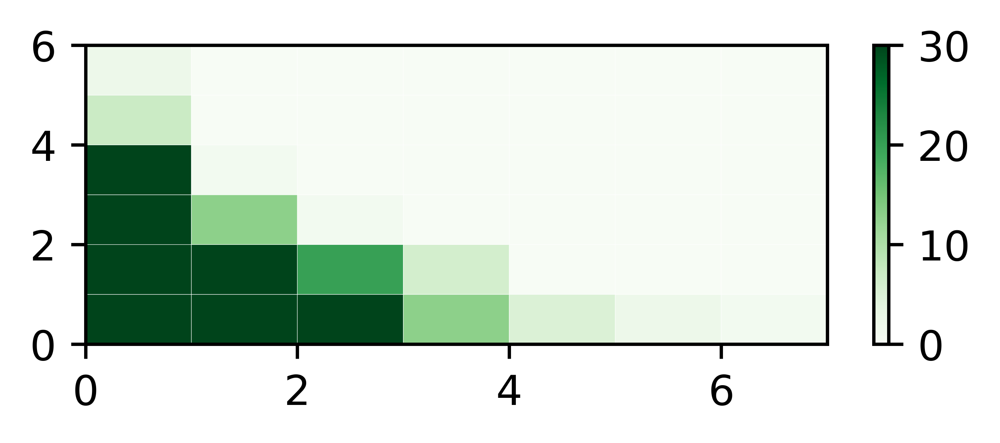

In [28]:
plt.figure(dpi=800,figsize=(4,1.3))
plt.pcolor(map_up.astype(int), vmin=0, vmax=30, cmap='Greens', edgecolors='w', linewidth=0.1)
plt.colorbar()  # Optional: to add a colorbar
#plt.xticks([])
#plt.yticks([])
plt.show()

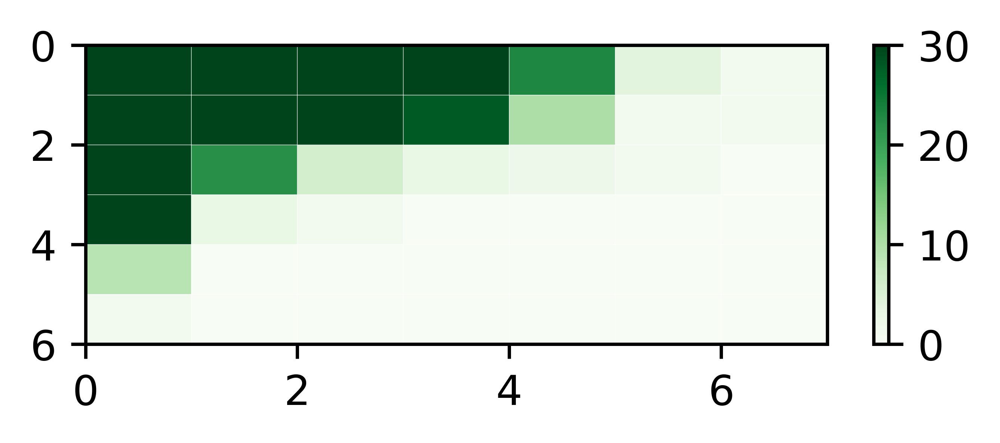

In [29]:
plt.figure(dpi=800,figsize=(4,1.3))
plt.pcolor(map_down.astype(int), vmin=0, vmax=30, cmap='Greens', edgecolors='w', linewidth=0.1)
plt.colorbar()  # Optional: to add a colorbar
plt.gca().invert_yaxis()  # Revert the y-axis
#plt.xticks([])
#plt.yticks([])
plt.show()

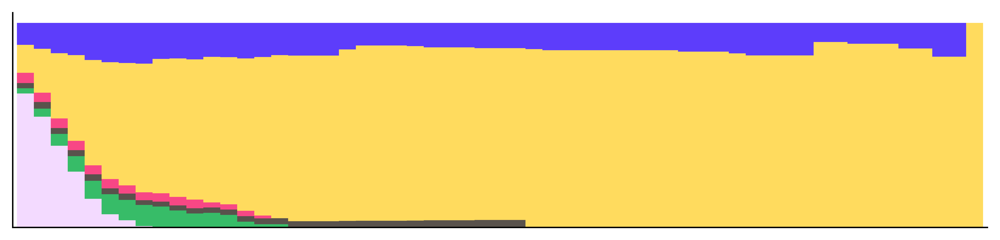

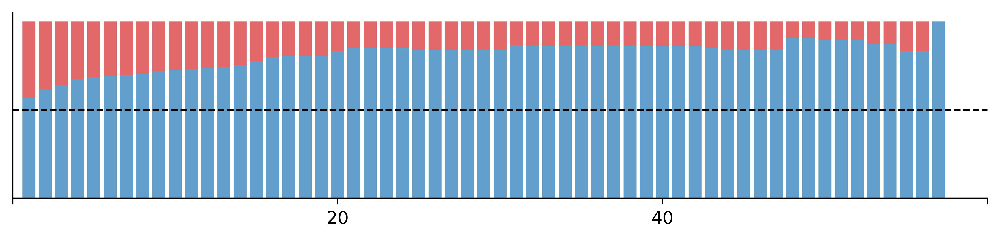

In [30]:
chrX_total = figure_all.heatmapigure2b(TS_data_df, nDE_share_across_cell_tissue)

In [31]:
test =TS_data_df.merge(nDE_share_across_cell_tissue, on='gene_symbol')

test[test['type_new2']=='Autosomal-coding'].sort_values('number')['gene_symbol'].unique()[-6:]

array(['NABP1', 'DNAJB1', 'MKNK2', 'BTN3A1', 'ZFP36L2', 'HSPA1A'],
      dtype=object)

In [32]:
test[test.gene_symbol=='NABP1']

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,...,female donor num,chr,gene_type,chr_new,chr_gene_type,type_new,coding,type_new2,tissue_cell_type,number
54,1.410696,7.838534,30.607453,3.158779e-08,0.000004,NABP1,Bladder,t cell,2191,5211,...,4,chr2,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell,7
619,-1.889942,8.096795,24.859386,6.166805e-07,0.000050,NABP1,Bladder,granulocyte,470,1168,...,4,chr2,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_granulocyte,7
1722,-2.530554,5.011375,24.493202,7.457249e-07,0.000159,NABP1,Bone_Marrow,stem cell,1040,728,...,3,chr2,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bone_Marrow_stem cell,7
2240,-2.252761,7.963423,30.224239,3.848693e-08,0.000007,NABP1,Bone_Marrow,myeloid leukocyte,1187,1256,...,3,chr2,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bone_Marrow_myeloid leukocyte,7
5236,1.414946,4.830567,23.068697,1.563150e-06,0.000210,NABP1,Tongue,epithelial cell,7424,7790,...,2,chr2,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Tongue_epithelial cell,7
5821,1.142429,5.984766,19.196328,1.179400e-05,0.000650,NABP1,Trachea,epithelial cell,937,9082,...,3,chr2,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Trachea_epithelial cell,7
6402,1.143250,8.304658,25.666693,4.057701e-07,0.000039,NABP1,Vasculature,myeloid leukocyte,5261,2318,...,3,chr2,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_myeloid leukocyte,7


In [34]:
TS_data_df.loc['GNG5',:]

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,chr_new,chr_gene_type,type_new,coding,type_new2,tissue_cell_type
GNG5,-1.234890,5.560512,19.866064,8.306179e-06,0.000930,GNG5,Spleen,lymphocyte of b lineage,6009,13558,2,4,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Spleen_lymphocyte of b lineage
GNG5,-1.089401,6.163204,24.186143,8.745928e-07,0.000041,GNG5,Spleen,innate lymphoid cell,1379,2627,2,4,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Spleen_innate lymphoid cell
GNG5,-1.108401,5.743492,22.934964,1.675758e-06,0.000167,GNG5,Spleen,t cell,6250,10855,2,4,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Spleen_t cell
GNG5,1.467854,6.187071,33.794884,6.123970e-09,0.000002,GNG5,Vasculature,fibroblast,7076,5054,2,3,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_fibroblast
GNG5,1.004326,6.443351,18.009572,2.197970e-05,0.000893,GNG5,Vasculature,myeloid leukocyte,5261,2318,2,3,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_myeloid leukocyte


In [35]:
TS_data_df['type_new2'].unique()

array(['chrY', 'chrX', 'Autosomal-coding', 'MT-mt', 'Autosomal-ribosomal',
       'Autosomal-noncoding', 'nan'], dtype=object)

In [113]:
concor_scores_auto_noncoding = utils.get_concordance_histogram(TS_data_df[TS_data_df['type_new2']=='Autosomal-noncoding'], nDE_share_across_cell_tissue)

concor_scores_autu_ribo = utils.get_concordance_histogram(TS_data_df[TS_data_df['type_new2']=='Autosomal-ribosomal'], nDE_share_across_cell_tissue)

concor_scores_chrY = utils.get_concordance_histogram(TS_data_df[TS_data_df['type_new2']=='chrY'], nDE_share_across_cell_tissue)

concor_scores_chrX = utils.get_concordance_histogram(TS_data_df[TS_data_df['type_new2']=='chrX'], nDE_share_across_cell_tissue)

concor_scores_auto_coding = utils.get_concordance_histogram(TS_data_df[TS_data_df['type_new2']=='Autosomal-coding'], nDE_share_across_cell_tissue)


concor_scores_mt = utils.get_concordance_histogram(TS_data_df[TS_data_df['type_new2']=='MT-mt'], nDE_share_across_cell_tissue)


/hpc/mydata/siyu.he/Siyu_projects/TSP_analysis/TS_DEG_method/utils.py:95: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


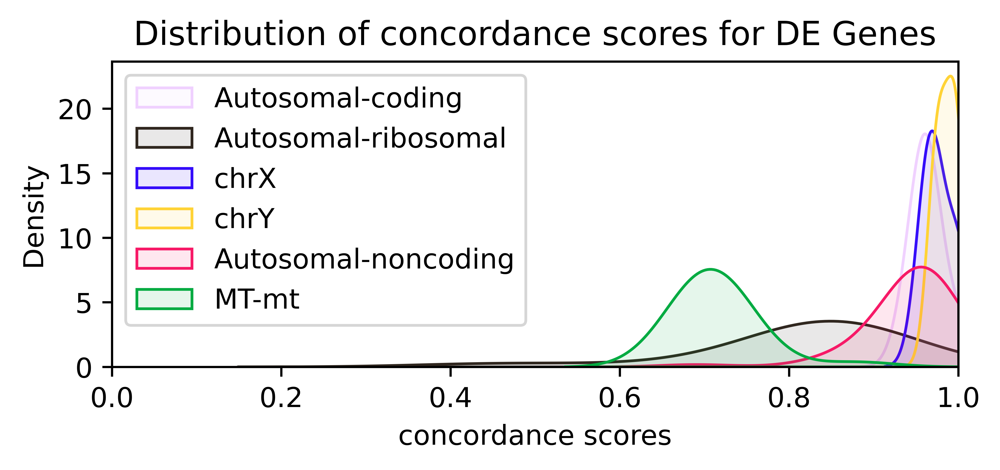

In [117]:
# Plotting
plt.figure(figsize=(5.5,2),dpi=800)
# Histogram for comparison
sns.kdeplot(concor_scores_auto_coding, fill=True, alpha=0.1, bw_adjust=2, label='Autosomal-coding',color='#f0d1ff')
sns.kdeplot(concor_scores_autu_ribo, fill=True, alpha=0.1, bw_adjust=2, label='Autosomal-ribosomal',color='#30271f')
sns.kdeplot(concor_scores_chrX, fill=True, alpha=0.1, bw_adjust=2, label='chrX',color='#340cfa')
sns.kdeplot(concor_scores_chrY,fill=True, alpha=0.1, bw_adjust=2, label='chrY',color='#ffd336')
sns.kdeplot(concor_scores_auto_noncoding, fill=True, alpha=0.1,bw_adjust=2,  label='Autosomal-noncoding',color='#f71967')
sns.kdeplot(concor_scores_mt, fill=True, alpha=0.1,bw_adjust=2,  label='MT-mt',color='#05ab42')


plt.xlim([0,1])
plt.ylabel('Density')
plt.xlabel('concordance scores')
plt.title('Distribution of concordance scores for DE Genes')
plt.legend(loc='upper left')
plt.savefig('panelD.pdf',dpi=800,format='pdf')



In [38]:
all_kdeplotance_data = utils.get_concordance(TS_data_df, nDE_share_across_cell_tissue)


chrY


/hpc/mydata/siyu.he/Siyu_projects/TSP_analysis/TS_DEG_method/utils.py:169: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


chrX
Autosomal-coding
MT-mt
Autosomal-ribosomal
Autosomal-noncoding
nan


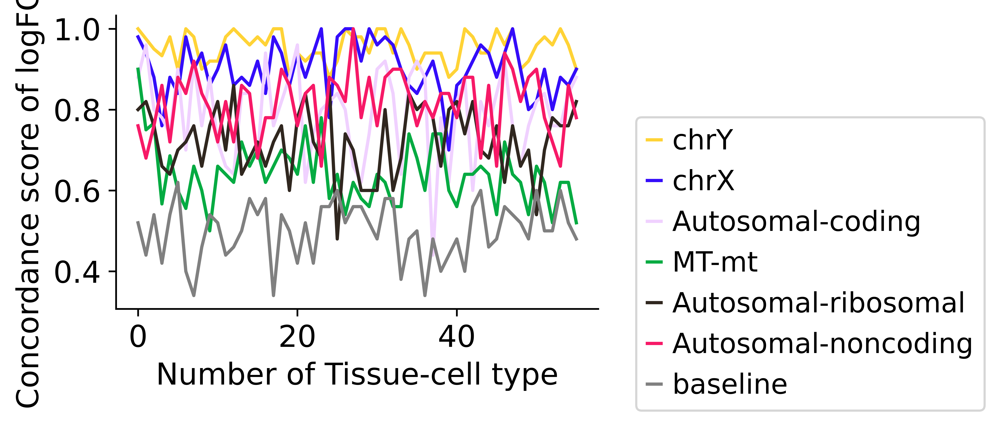

In [152]:
figure_all.plot_figure3a(all_kdeplotance_data,x_label='Tissue-cell type')


In [40]:
# cell & tissue
folder_path= '/hpc/projects/tabula_sapiens/singlecell_transcriptomics/TSP1_30_Paper2_Version2d_Oct2024/tissues/'
file_path_list_ = os.listdir(folder_path)
file_path_list = []


all_chrX_exp = pd.DataFrame()
genes_list = TS_data_df['gene_symbol'].unique() 
for tissue_ in sorted(TS_data_df['tissue'].unique()):
    print(tissue_)
    for j in file_path_list_:
        if j.startswith(tissue_):
            adata_tissue_path = folder_path+j
            adata_tissue = sc.read_h5ad(adata_tissue_path)
            adata_tissue = adata_tissue[adata_tissue.obs['method']!='smartseq'].copy()
            for type_ in sorted(TS_data_df['cell_type'].unique()):
                print(type_)
                temp_path = '/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+type_.replace(' ', '_')+'.h5ad'
                if os.path.exists(temp_path):
                    print(tissue_+' '+type_)
                    refer_adata = sc.read_h5ad(temp_path)
                    adata_tissue_ct = adata_tissue[adata_tissue.obs['broad_cell_class']==type_].copy()
                    adata_tissue_ct = adata_tissue_ct[refer_adata.obs_names,:]
                    adata_tissue_ct = adata_tissue_ct[:,np.intersect1d(genes_list,adata_tissue_ct.var_names)].copy().layers['decontXcounts'].mean(axis=0)
                    all_chrX_exp[tissue_+'_'+type_] = np.array(adata_tissue_ct).flatten()

Bladder


KeyboardInterrupt: 

In [ ]:
all_chrX_exp

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Assuming all_chrX_exp is a pandas DataFrame with genes as rows and samples/conditions as columns
# Calculate the correlation matrix
correlation_matrix = all_chrX_exp.corr()

# Perform hierarchical clustering
linked = linkage(correlation_matrix, 'ward')

# Plot the hierarchical clustering as a dendrogram
sns.clustermap(correlation_matrix, method='single', cmap='coolwarm', figsize=(10, 10))

# Show the plot
plt.show()

In [ ]:
tissue_color_dict = {
         'Bladder': '#e7969c',
         'Blood': '#d6616b',
         'Bone': '#cedb9c',
         'Ear':"#00ff7f",
         'Eye': '#c7ea46',
         'Fat': '#e7cb94',
         'Heart': '#ff0800',
         'Kidney': '#7b4173',
         'Large': '#31a354',
         'Liver': '#000080',
         'Lung': '#3182bd',
         'Lymph': '#8c6d31',
         'Mammary':'#ce6dbd',
         'Muscle': '#e7ba52',
         'Ovary':'#a55194',
         'Pancreas': '#fd8d3c',
         'Prostate':'#637939',#
         'Salivary':'#622a0f',
         'Skin': '#de9ed6',
         'Small': '#6baed6',
         'Spleen': '#393b79',
         'Stomach' :'#ff0090',
         'Testis':'#0a0a0a',
         'Thymus': '#9c9ede',
         'Tongue':'#b5cf6b',
         'Trachea': '#969696',
         'Uterus':'#c64b8c',
         'Vasculature': '#843c39'}


In [ ]:
broad_celltype_color_dict = {
 'adventitial cell': '#b5cf6b',
 'cardiac endothelial cell': '#393b79',
 'ciliated epithelial cell': '#e377c2',
 'conjunctival epithelial cell': '#e7cb94',
 'connective tissue cell': '#843c39',
 'contractile cell': '#98df8a',
 'dendritic cell': '#9edae5',
 'duct epithelial cell': '#9c9ede',
 'ecto-epithelial cell': '#bd9e39',
 'endo-epithelial cell': '#8c564b',
 'endothelial cell': '#d62728',
 'epithelial cell': '#7f7f7f',
 'epithelial cell of lung': '#8ca252',
 'erythroid lineage cell': '#ff9896',
 'fibroblast': '#ffbb78',
 'glandular epithelial cell': '#dbdb8d',
 'glial cell': '#6b6ecf',
 'granulocyte': '#ff7f0e',
 'hematopoietic cell': '#c7c7c7',
 'hepatocyte': '#d6616b',
 'innate lymphoid cell': '#9467bd',
 'intestinal epithelial cell': '#bcbd22',
 'lymphocyte of b lineage': '#c5b0d5',
 'melanocyte': '#637939',
 'meso-epithelial cell': '#c49c94',
 'myeloid leukocyte': '#1f77b4',
 'neuron': '#8c6d31',
 'retinal pigment epithelial cell': '#a55194',
 'secretory cell': '#f7b6d2',
 'stem cell': '#aec7e8',
 'stratified epithelial cell': '#ad494a',
 'stromal cell': '#5254a3',
 't cell': '#2ca02c',
 'transitional epithelial cell': '#17becf'}

In [ ]:
type_map_dict = {
    'cardiac endothelial cell':'endothelial cell', 
    'contractile cell':'contractile cell', 
    'endothelial cell':'endothelial cell',
    'epithelial cell':'epithelial cell', 
    'erythroid lineage cell':'', 
    'fibroblast':'fibroblast',
    'granulocyte':'granulocyte', 
    'hematopoietic cell': 'stem cell', 
    'innate lymphoid cell':'innate lymphoid cell',
    'lymphocyte of b lineage':'lymphocyte of b lineage', 
    'myeloid leukocyte':'myeloid leukocyte', 
    'secretory cell':'secretory cell',
    'stem cell':'stem cell', 
    'stratified epithelial cell':'epithelial cell', 
    'stromal cell':'epithelial cell',
    't cell':'t cell', 
    'transitional epithelial cell':'epithelial cell'
}

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage, leaves_list
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

correlation_matrix = all_chrX_exp.corr(method='kendall')
linkage_result = linkage(correlation_matrix, method='ward')
dendro = dendrogram(linkage_result, no_plot=True)
order = dendro['leaves']

ordered_corr_matrix = correlation_matrix.iloc[order, :].iloc[:, order]
mask = np.triu(np.ones_like(ordered_corr_matrix, dtype=bool), k=1)
masked_corr_matrix = ordered_corr_matrix.mask(mask)
reordered_categories = masked_corr_matrix.columns
reordered_categories = [i.split('_')[0] for i in reordered_categories]
reordered_categories2 = [i.split('_')[-1:][0] for i in masked_corr_matrix.columns]
#reordered_categories2 = pd.DataFrame(reordered_categories2,columns=['ct'])['ct'].map(type_map_dict)

    
# Create a figure and axes to plot the heatmap
fig, ax = plt.subplots(figsize=(7,6), dpi=900)

# Plot the heatmap
sns.heatmap(ordered_corr_matrix, cmap='coolwarm', ax=ax, mask=mask,xticklabels=False,
            yticklabels=False,vmax=0.8, vmin=0.3)
# Add color patches
for i, cat in enumerate(reordered_categories):
    ax.add_patch(plt.Rectangle((i, len(reordered_categories)+0.1), 1, 2, 
                               color=tissue_color_dict[cat], lw=0))
# Add color patches
#for i, cat in enumerate(reordered_categories2):
#    ax.add_patch(plt.Rectangle((i, len(reordered_categories)+2.5), 1, 2, 
#                               color=broad_celltype_color_dict[cat], lw=0))
    
for i, cat in enumerate(reordered_categories):
    ax.add_patch(plt.Rectangle((-2.1,i), 2,1, 
                               color=tissue_color_dict[cat], lw=0))
#for i, cat in enumerate(reordered_categories2):
#    ax.add_patch(plt.Rectangle((-4.5,i), 2,1, 
#                               color=broad_celltype_color_dict[cat], lw=0))
# Adjust the plot limits for visibility of patches
ax.set_ylim(len(reordered_categories)+10, -1)
ax.set_xlim(-10, len(reordered_categories)+10)


plt.show()

In [ ]:
np.unique(reordered_categories2)

In [ ]:

# Plot the table as a bar plot with colors
cell_types = list(broad_celltype_color_dict.keys())
colors = list(broad_celltype_color_dict.values())

# Create a bar plot with colors
plt.figure(figsize=(3, 6))
plt.barh(cell_types, [1] * len(cell_types), color=colors)
plt.xlabel('Cell Types')
plt.title('Broad Cell Types and Their Corresponding Colors')

# Display plot
plt.show()


In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt


# Create the dendrogram
fig, ax = plt.subplots(figsize=(20,2), dpi=800)  # Adjust the size as needed

# Plot the dendrogram, using column names as labels
dendro = dendrogram(linkage_result, ax=ax, above_threshold_color='gray',
                    orientation='top', color_threshold=0,
                    labels=correlation_matrix.columns)

# Rotate labels if they're not already rotated by default
ax.tick_params(axis='x', which='major', labelsize=8)  # Adjust the size as needed
plt.setp(ax.get_xticklabels(), rotation=90, ha="left")  # Rotate the x labels

# Remove the y ticks since they're not needed for the dendrogram
ax.yaxis.set_visible(False)
plt.show()

In [41]:
sex_diff_count = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/sex_diff_count.csv',index_col=0)
#edgeR_LRT_all_filtered =edgeR_LRT_all[edgeR_LRT_all.FDR<1e-3]
TS_data_df_filtered =TS_data_df[TS_data_df.type_new2=='Autosomal-coding']

In [42]:
TS_data_df_filtered

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,chr_new,chr_gene_type,type_new,coding,type_new2,tissue_cell_type
H4C3,-1.641814,8.514855,104.968459,1.240956e-24,8.493100e-22,H4C3,Bladder,t cell,2191,5211,2,4,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
CEBPB,-1.416521,7.683289,73.057985,1.258962e-17,6.627952e-15,CEBPB,Bladder,t cell,2191,5211,2,4,chr20,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
CRYBG1,-1.226227,10.046446,60.174576,8.680624e-15,3.494717e-12,CRYBG1,Bladder,t cell,2191,5211,2,4,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
TNFSF8,-1.246062,7.544407,51.925955,5.763353e-13,1.972219e-10,TNFSF8,Bladder,t cell,2191,5211,2,4,chr9,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
SRGN,-0.973206,11.456958,51.776401,6.219487e-13,2.026960e-10,SRGN,Bladder,t cell,2191,5211,2,4,chr10,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZBTB18,-0.834592,4.468594,20.286714,6.666187e-06,7.911431e-04,ZBTB18,Vasculature,endothelial cell,3154,2802,2,3,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell
PSENEN,0.860785,5.083190,19.947601,7.959374e-06,9.285585e-04,PSENEN,Vasculature,endothelial cell,3154,2802,2,3,chr19,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell
CTNNAL1,-0.663660,6.910313,19.942525,7.980533e-06,9.285585e-04,CTNNAL1,Vasculature,endothelial cell,3154,2802,2,3,chr9,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell
MCC,-1.038772,6.894973,19.884955,8.224502e-06,9.476543e-04,MCC,Vasculature,endothelial cell,3154,2802,2,3,chr5,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell


In [43]:
np.unique(TS_data_df_filtered[TS_data_df_filtered.tissue=='Heart'].cell_type)

array(['cardiac endothelial cell'], dtype=object)

In [44]:
sex_diff_count[sex_diff_count.tissue=='Heart']

,tissue,cell type,male cell num,female cell num,male donor num,female donor num
69,Heart,contractile cell,8877,2993,2,3
70,Heart,cardiac endothelial cell,4522,5360,2,3
71,Heart,myeloid leukocyte,227,539,2,3
72,Heart,fibroblast,476,1422,2,3


In [45]:
#sex_diff_count = sex_diff_count.drop(columns=['count_F_x','count_F_y','count_M_x','count_M_y'])

TS_data_df_filtered['color'] = TS_data_df_filtered['tissue'].map(utils.tissue_colors())
TS_data_df_filtered['count_F'] = 0
TS_data_df_filtered['count_M'] = 0
TS_data_df_filtered.loc[TS_data_df_filtered['logFC']>0,'count_F'] = 1
TS_data_df_filtered.loc[TS_data_df_filtered['logFC']<0,'count_M'] = 1


/tmp/ipykernel_382353/3080998369.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_382353/3080998369.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_382353/3080998369.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [46]:
TS_data_df_filtered_F = TS_data_df_filtered[['count_F','tissue_cell_type']].groupby('tissue_cell_type').sum().sort_values(by='count_F',ascending=False)
TS_data_df_filtered_M = TS_data_df_filtered[['count_M','tissue_cell_type']].groupby('tissue_cell_type').sum().sort_values(by='count_M',ascending=False)

TS_data_df_filtered_F = TS_data_df_filtered_F/41888 * 100
TS_data_df_filtered_M = TS_data_df_filtered_M/41888 * 100
TS_data_df_filtered_M = TS_data_df_filtered_M.reindex(TS_data_df_filtered_F.index)

sex_diff_count['tissue_cell_type'] = sex_diff_count['tissue'] + '_' +sex_diff_count['cell type']
sex_diff_count = sex_diff_count.merge(TS_data_df_filtered_F,how='left',on='tissue_cell_type')
sex_diff_count = sex_diff_count.merge(TS_data_df_filtered_M,how='left',on='tissue_cell_type')


In [47]:
sex_diff_count

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M
0,Bladder,t cell,2191,5211,2,4,Bladder_t cell,0.074007,0.114591
1,Bladder,transitional epithelial cell,4646,22017,2,4,Bladder_transitional epithelial cell,0.152788,0.124141
2,Bladder,fibroblast,3377,9892,2,4,Bladder_fibroblast,0.047746,0.140852
3,Bladder,myeloid leukocyte,1122,6518,2,4,Bladder_myeloid leukocyte,0.040584,0.095493
4,Bladder,contractile cell,1120,4077,2,4,Bladder_contractile cell,0.002387,0.011937
...,...,...,...,...,...,...,...,...,...
109,Vasculature,t cell,1942,644,2,3,Vasculature_t cell,0.007162,0.040584
110,Vasculature,fibroblast,7076,5054,2,3,Vasculature_fibroblast,0.116979,0.119366
111,Vasculature,myeloid leukocyte,5261,2318,2,3,Vasculature_myeloid leukocyte,0.224408,0.260218
112,Vasculature,endothelial cell,3154,2802,2,3,Vasculature_endothelial cell,0.062070,0.093105


In [48]:
TS_data_df_filtered_F

,count_F
tissue_cell_type,
Blood_myeloid leukocyte,0.752005
Salivary_Gland_myeloid leukocyte,0.627865
Bone_Marrow_granulocyte,0.300802
Spleen_innate lymphoid cell,0.300802
Vasculature_myeloid leukocyte,0.224408
Fat_granulocyte,0.162338
Salivary_Gland_t cell,0.159950
Salivary_Gland_fibroblast,0.157563
Bladder_transitional epithelial cell,0.152788


In [49]:
sex_diff_count

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M
0,Bladder,t cell,2191,5211,2,4,Bladder_t cell,0.074007,0.114591
1,Bladder,transitional epithelial cell,4646,22017,2,4,Bladder_transitional epithelial cell,0.152788,0.124141
2,Bladder,fibroblast,3377,9892,2,4,Bladder_fibroblast,0.047746,0.140852
3,Bladder,myeloid leukocyte,1122,6518,2,4,Bladder_myeloid leukocyte,0.040584,0.095493
4,Bladder,contractile cell,1120,4077,2,4,Bladder_contractile cell,0.002387,0.011937
...,...,...,...,...,...,...,...,...,...
109,Vasculature,t cell,1942,644,2,3,Vasculature_t cell,0.007162,0.040584
110,Vasculature,fibroblast,7076,5054,2,3,Vasculature_fibroblast,0.116979,0.119366
111,Vasculature,myeloid leukocyte,5261,2318,2,3,Vasculature_myeloid leukocyte,0.224408,0.260218
112,Vasculature,endothelial cell,3154,2802,2,3,Vasculature_endothelial cell,0.062070,0.093105


In [50]:
sex_diff_count.fillna(0, inplace=True)

sex_diff_count['color'] = sex_diff_count['tissue'].map(utils.tissue_colors())
sex_diff_count['total_cell_num'] = sex_diff_count['male cell num'] + sex_diff_count['female cell num']

In [51]:
sex_diff_count[sex_diff_count.tissue=='Heart']

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M,color,total_cell_num
29,Heart,contractile cell,8877,2993,2,3,Heart_contractile cell,0.000000,0.000000,#ff0800,11870
30,Heart,cardiac endothelial cell,4522,5360,2,3,Heart_cardiac endothelial cell,0.045359,0.038197,#ff0800,9882
31,Heart,myeloid leukocyte,227,539,2,3,Heart_myeloid leukocyte,0.000000,0.000000,#ff0800,766
32,Heart,fibroblast,476,1422,2,3,Heart_fibroblast,0.000000,0.000000,#ff0800,1898


In [154]:
plt.figure(figsize=(5,5), dpi=800)

plt.plot(np.linspace(-1,6,10),np.linspace(-1,6,10),'--',c='k',linewidth=0.7)


sizes = np.minimum(sex_diff_count['total_cell_num']/100, 150)  # Capping the size

# Plot using the capped sizes
plt.scatter((sex_diff_count['count_F']),(sex_diff_count['count_M']), s=sizes, color=sex_diff_count['color'])

plt.ylim([-0.05,0.8])
plt.xlim([-0.05,0.8])


# Example legend - manually add scatter plots for legend entries
for size in [50, 100,]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'{size}00')
for size in [150]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'>{size}00')

plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title='Size')

plt.grid(False)
plt.savefig('supp8_panelC.pdf',dpi=800,format='pdf')



In [53]:
sex_diff_count.sort_values(by='count_M')

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M,color,total_cell_num
47,Lung,endo-epithelial cell,466,1256,2,2,Lung_endo-epithelial cell,0.000000,0.000000,#3182bd,1722
57,Muscle,contractile cell,618,2246,2,3,Muscle_contractile cell,0.007162,0.000000,#e7ba52,2864
56,Lymph_Node,granulocyte,207,293,2,4,Lymph_Node_granulocyte,0.000000,0.000000,#8c6d31,500
54,Lymph_Node,innate lymphoid cell,679,846,2,4,Lymph_Node_innate lymphoid cell,0.002387,0.000000,#8c6d31,1525
52,Lymph_Node,lymphocyte of b lineage,25017,34532,2,4,Lymph_Node_lymphocyte of b lineage,0.002387,0.000000,#8c6d31,59549
...,...,...,...,...,...,...,...,...,...,...,...
111,Vasculature,myeloid leukocyte,5261,2318,2,3,Vasculature_myeloid leukocyte,0.224408,0.260218,#843c39,7579
105,Trachea,epithelial cell,937,9082,2,3,Trachea_epithelial cell,0.109817,0.343774,#969696,10019
85,Spleen,innate lymphoid cell,1379,2627,2,4,Spleen_innate lymphoid cell,0.300802,0.498950,#393b79,4006
8,Blood,myeloid leukocyte,4415,17437,4,5,Blood_myeloid leukocyte,0.752005,0.615928,#d6616b,21852


In [54]:
sex_diff_count.sort_values(by='count_F')

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M,color,total_cell_num
47,Lung,endo-epithelial cell,466,1256,2,2,Lung_endo-epithelial cell,0.000000,0.000000,#3182bd,1722
62,Muscle,stromal cell,126,242,2,3,Muscle_stromal cell,0.000000,0.000000,#e7ba52,368
61,Muscle,t cell,274,1123,2,3,Muscle_t cell,0.000000,0.000000,#e7ba52,1397
56,Lymph_Node,granulocyte,207,293,2,4,Lymph_Node_granulocyte,0.000000,0.000000,#8c6d31,500
55,Lymph_Node,myeloid leukocyte,1872,1576,2,4,Lymph_Node_myeloid leukocyte,0.000000,0.002387,#8c6d31,3448
...,...,...,...,...,...,...,...,...,...,...,...
111,Vasculature,myeloid leukocyte,5261,2318,2,3,Vasculature_myeloid leukocyte,0.224408,0.260218,#843c39,7579
85,Spleen,innate lymphoid cell,1379,2627,2,4,Spleen_innate lymphoid cell,0.300802,0.498950,#393b79,4006
16,Bone_Marrow,granulocyte,7271,1484,3,3,Bone_Marrow_granulocyte,0.300802,0.245894,#cedb9c,8755
64,Salivary_Gland,myeloid leukocyte,1993,336,2,2,Salivary_Gland_myeloid leukocyte,0.627865,0.673224,#622a0f,2329


In [55]:
TS_data_df_filtered

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,...,gene_type,chr_new,chr_gene_type,type_new,coding,type_new2,tissue_cell_type,color,count_F,count_M
H4C3,-1.641814,8.514855,104.968459,1.240956e-24,8.493100e-22,H4C3,Bladder,t cell,2191,5211,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell,#e7969c,0,1
CEBPB,-1.416521,7.683289,73.057985,1.258962e-17,6.627952e-15,CEBPB,Bladder,t cell,2191,5211,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell,#e7969c,0,1
CRYBG1,-1.226227,10.046446,60.174576,8.680624e-15,3.494717e-12,CRYBG1,Bladder,t cell,2191,5211,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell,#e7969c,0,1
TNFSF8,-1.246062,7.544407,51.925955,5.763353e-13,1.972219e-10,TNFSF8,Bladder,t cell,2191,5211,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell,#e7969c,0,1
SRGN,-0.973206,11.456958,51.776401,6.219487e-13,2.026960e-10,SRGN,Bladder,t cell,2191,5211,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell,#e7969c,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZBTB18,-0.834592,4.468594,20.286714,6.666187e-06,7.911431e-04,ZBTB18,Vasculature,endothelial cell,3154,2802,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell,#843c39,0,1
PSENEN,0.860785,5.083190,19.947601,7.959374e-06,9.285585e-04,PSENEN,Vasculature,endothelial cell,3154,2802,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell,#843c39,1,0
CTNNAL1,-0.663660,6.910313,19.942525,7.980533e-06,9.285585e-04,CTNNAL1,Vasculature,endothelial cell,3154,2802,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell,#843c39,0,1
MCC,-1.038772,6.894973,19.884955,8.224502e-06,9.476543e-04,MCC,Vasculature,endothelial cell,3154,2802,...,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_endothelial cell,#843c39,0,1


In [56]:
TS_data_df_filtered_F = TS_data_df_filtered[TS_data_df_filtered['logFC']>0]
TS_data_df_filtered_M = TS_data_df_filtered[TS_data_df_filtered['logFC']<0]


TS_data_df_filtered_F = TS_data_df_filtered_F[['logFC','tissue_cell_type']].groupby('tissue_cell_type').mean().sort_values(by='logFC',ascending=False)
TS_data_df_filtered_F.columns = ['logFC_mean_F']
TS_data_df_filtered_M = TS_data_df_filtered_M[['logFC','tissue_cell_type']].groupby('tissue_cell_type').mean().sort_values(by='logFC',ascending=False)
TS_data_df_filtered_M.columns = ['logFC_mean_M']

sex_diff_count = sex_diff_count.merge(TS_data_df_filtered_F,how='left',on='tissue_cell_type')
sex_diff_count = sex_diff_count.merge(TS_data_df_filtered_M,how='left',on='tissue_cell_type')



In [57]:
sex_diff_count.fillna(0, inplace=True)

In [58]:
sex_diff_count[sex_diff_count.tissue=='Heart']

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M,color,total_cell_num,logFC_mean_F,logFC_mean_M
29,Heart,contractile cell,8877,2993,2,3,Heart_contractile cell,0.000000,0.000000,#ff0800,11870,0.000000,0.000000
30,Heart,cardiac endothelial cell,4522,5360,2,3,Heart_cardiac endothelial cell,0.045359,0.038197,#ff0800,9882,1.419909,-1.589509
31,Heart,myeloid leukocyte,227,539,2,3,Heart_myeloid leukocyte,0.000000,0.000000,#ff0800,766,0.000000,0.000000
32,Heart,fibroblast,476,1422,2,3,Heart_fibroblast,0.000000,0.000000,#ff0800,1898,0.000000,0.000000


In [59]:
(sex_diff_count['count_F']**2+sex_diff_count['count_M']**2).min()

0.0

In [60]:
#sex_diff_count_filter = sex_diff_count[(sex_diff_count['count_F']**2+sex_diff_count['count_M']**2)>0.05**2]
sex_diff_count_filter = sex_diff_count[(sex_diff_count['count_F']**2+sex_diff_count['count_M']**2)>0.02**2]

In [61]:
sex_diff_count_filter

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M,color,total_cell_num,logFC_mean_F,logFC_mean_M
0,Bladder,t cell,2191,5211,2,4,Bladder_t cell,0.074007,0.114591,#e7969c,7402,1.365277,-0.881597
1,Bladder,transitional epithelial cell,4646,22017,2,4,Bladder_transitional epithelial cell,0.152788,0.124141,#e7969c,26663,1.651321,-1.018252
2,Bladder,fibroblast,3377,9892,2,4,Bladder_fibroblast,0.047746,0.140852,#e7969c,13269,1.491916,-1.022977
3,Bladder,myeloid leukocyte,1122,6518,2,4,Bladder_myeloid leukocyte,0.040584,0.095493,#e7969c,7640,1.153445,-1.199157
5,Bladder,granulocyte,470,1168,2,4,Bladder_granulocyte,0.054908,0.224408,#e7969c,1638,1.898826,-2.394839
7,Blood,innate lymphoid cell,769,2216,4,5,Blood_innate lymphoid cell,0.035810,0.047746,#d6616b,2985,1.028444,-0.895667
8,Blood,myeloid leukocyte,4415,17437,4,5,Blood_myeloid leukocyte,0.752005,0.615928,#d6616b,21852,0.727846,-0.642102
9,Blood,lymphocyte of b lineage,2132,2370,4,5,Blood_lymphocyte of b lineage,0.031035,0.033422,#d6616b,4502,0.944521,-1.166149
12,Blood,granulocyte,20835,10980,4,5,Blood_granulocyte,0.090718,0.119366,#d6616b,31815,1.090141,-0.920681
14,Bone_Marrow,stem cell,1040,728,3,3,Bone_Marrow_stem cell,0.062070,0.035810,#cedb9c,1768,2.044885,-2.375694


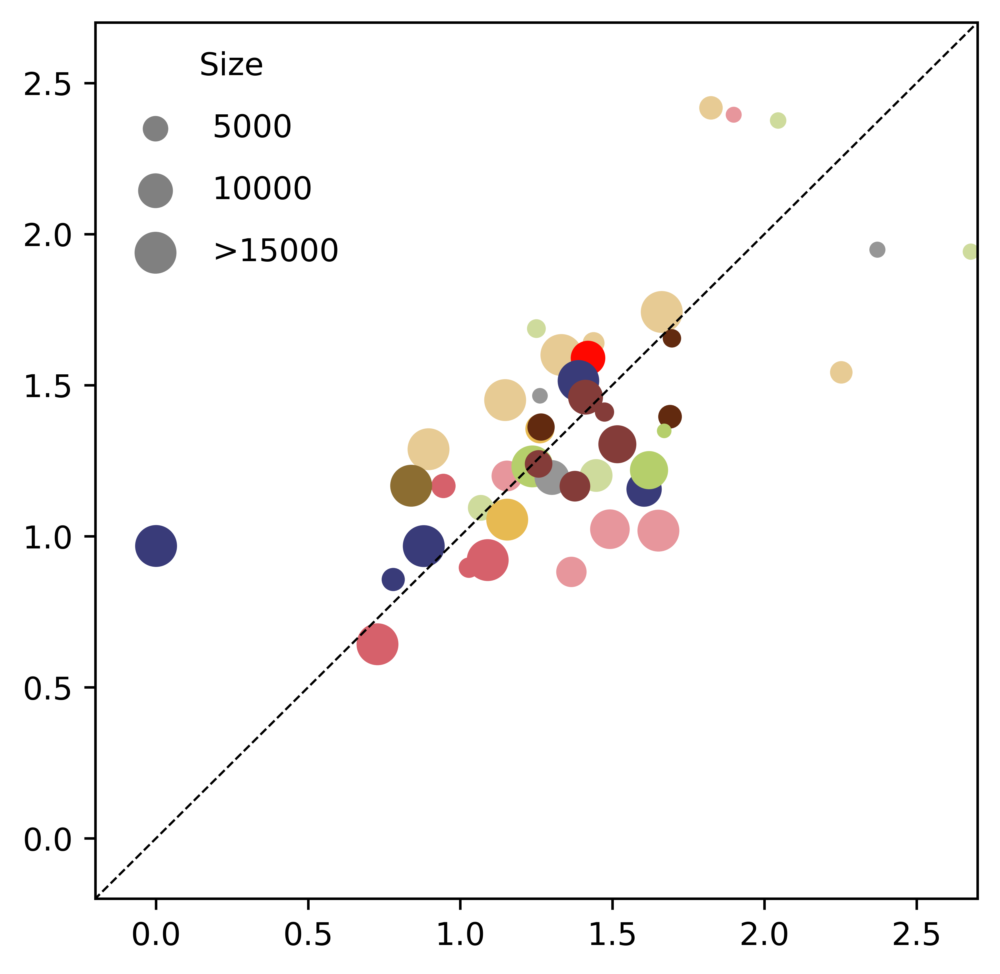

In [118]:
plt.figure(figsize=(5.,5.), dpi=800)

plt.plot(np.linspace(-1,12,12),np.linspace(-1,12,12),'--',c='k',linewidth=0.7)


sizes = np.minimum(sex_diff_count_filter['total_cell_num']/100, 150)  # Capping the size
# Plot using the capped sizes
plt.scatter(sex_diff_count_filter['logFC_mean_F'], -
            sex_diff_count_filter['logFC_mean_M'], s=sizes, 
            color=sex_diff_count_filter['color'])

#plt.ylim([0.35,1.8])
#plt.xlim([0.35,1.8])
plt.ylim([-0.2,2.7])
plt.xlim([-0.2,2.7])
# Example legend - manually add scatter plots for legend entries
for size in [50, 100,]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'{size}00')
for size in [150]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'>{size}00')

plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title='Size')

plt.savefig('panelE.pdf',dpi=800,format='pdf')


In [63]:
sex_diff_count_filter.sort_values(by='logFC_mean_F')[-30:]

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M,color,total_cell_num,logFC_mean_F,logFC_mean_M
17,Bone_Marrow,myeloid leukocyte,1187,1256,3,3,Bone_Marrow_myeloid leukocyte,0.074007,0.150401,#cedb9c,2443,1.250213,-1.686949
112,Vasculature,endothelial cell,3154,2802,2,3,Vasculature_endothelial cell,0.062070,0.093105,#843c39,5956,1.257456,-1.239025
59,Muscle,endothelial cell,942,5760,2,3,Muscle_endothelial cell,0.014324,0.031035,#e7ba52,6702,1.261717,-1.355141
106,Trachea,t cell,1268,284,2,3,Trachea_t cell,0.040584,0.143239,#969696,1552,1.261909,-1.464578
66,Salivary_Gland,t cell,3929,1882,2,2,Salivary_Gland_t cell,0.159950,0.164725,#622a0f,5811,1.265534,-1.361088
105,Trachea,epithelial cell,937,9082,2,3,Trachea_epithelial cell,0.109817,0.343774,#969696,10019,1.301362,-1.193976
21,Fat,myeloid leukocyte,11959,3816,3,3,Fat_myeloid leukocyte,0.097880,0.057296,#e7cb94,15775,1.332420,-1.599495
0,Bladder,t cell,2191,5211,2,4,Bladder_t cell,0.074007,0.114591,#e7969c,7402,1.365277,-0.881597
111,Vasculature,myeloid leukocyte,5261,2318,2,3,Vasculature_myeloid leukocyte,0.224408,0.260218,#843c39,7579,1.376864,-1.165298
83,Spleen,granulocyte,7061,7674,2,4,Spleen_granulocyte,0.016711,0.038197,#393b79,14735,1.388451,-1.513980


In [64]:
sex_diff_count_filter.sort_values(by='logFC_mean_M')[:30]

,tissue,cell type,male cell num,female cell num,male donor num,female donor num,tissue_cell_type,count_F,count_M,color,total_cell_num,logFC_mean_F,logFC_mean_M
26,Fat,contractile cell,3969,170,3,2,Fat_contractile cell,0.002387,0.038197,#e7cb94,4139,1.824082,-2.417564
5,Bladder,granulocyte,470,1168,2,4,Bladder_granulocyte,0.054908,0.224408,#e7969c,1638,1.898826,-2.394839
14,Bone_Marrow,stem cell,1040,728,3,3,Bone_Marrow_stem cell,0.062070,0.035810,#cedb9c,1768,2.044885,-2.375694
102,Trachea,fibroblast,1424,247,2,3,Trachea_fibroblast,0.050134,0.148014,#969696,1671,2.371208,-1.948137
18,Bone_Marrow,hematopoietic cell,1246,474,3,3,Bone_Marrow_hematopoietic cell,0.002387,0.040584,#cedb9c,1720,2.678343,-1.941634
28,Fat,lymphocyte of b lineage,9928,5133,3,2,Fat_lymphocyte of b lineage,0.031035,0.033422,#e7cb94,15061,1.662279,-1.741994
17,Bone_Marrow,myeloid leukocyte,1187,1256,3,3,Bone_Marrow_myeloid leukocyte,0.074007,0.150401,#cedb9c,2443,1.250213,-1.686949
64,Salivary_Gland,myeloid leukocyte,1993,336,2,2,Salivary_Gland_myeloid leukocyte,0.627865,0.673224,#622a0f,2329,1.695762,-1.654694
23,Fat,granulocyte,2395,1090,3,3,Fat_granulocyte,0.162338,0.116979,#e7cb94,3485,1.438292,-1.639241
21,Fat,myeloid leukocyte,11959,3816,3,3,Fat_myeloid leukocyte,0.097880,0.057296,#e7cb94,15775,1.332420,-1.599495


In [65]:
sex_diff_count['logFC_mean_all'] = sex_diff_count['logFC_mean_F']- sex_diff_count['logFC_mean_M']

<Axes: ylabel='Density'>

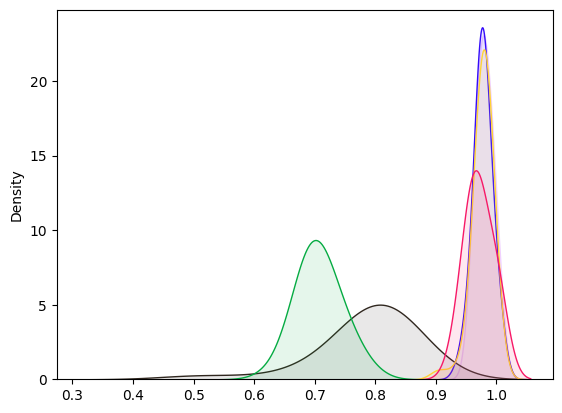

In [66]:
# Histogram for comparison
sns.kdeplot(concor_scores_auto_coding, fill=True, alpha=0.1, bw_adjust=2, label='Autosomal-coding',color='#f0d1ff')
sns.kdeplot(concor_scores_autu_ribo, fill=True, alpha=0.1, bw_adjust=2, label='Autosomal-ribosomal',color='#30271f')
sns.kdeplot(concor_scores_chrX, fill=True, alpha=0.1, bw_adjust=2, label='chrX',color='#340cfa')
sns.kdeplot(concor_scores_chrY,fill=True, alpha=0.1, bw_adjust=2, label='chrY',color='#ffd336')
sns.kdeplot(concor_scores_auto_noncoding, fill=True, alpha=0.1,bw_adjust=2,  label='Autosomal-noncoding',color='#f71967')
sns.kdeplot(concor_scores_mt, fill=True, alpha=0.1,bw_adjust=2,  label='MT-mt',color='#05ab42')


In [67]:
TS_data_df[(TS_data_df.cell_type=='t cell')&(TS_data_df.chr_gene_type=='autosomal_protein_coding')]

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,chr_new,chr_gene_type,type_new,coding,type_new2,tissue_cell_type
H4C3,-1.641814,8.514855,104.968459,1.240956e-24,8.493100e-22,H4C3,Bladder,t cell,2191,5211,2,4,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
CEBPB,-1.416521,7.683289,73.057985,1.258962e-17,6.627952e-15,CEBPB,Bladder,t cell,2191,5211,2,4,chr20,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
CRYBG1,-1.226227,10.046446,60.174576,8.680624e-15,3.494717e-12,CRYBG1,Bladder,t cell,2191,5211,2,4,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
TNFSF8,-1.246062,7.544407,51.925955,5.763353e-13,1.972219e-10,TNFSF8,Bladder,t cell,2191,5211,2,4,chr9,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
SRGN,-0.973206,11.456958,51.776401,6.219487e-13,2.026960e-10,SRGN,Bladder,t cell,2191,5211,2,4,chr10,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Bladder_t cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GLUL,-1.611670,6.913504,21.626837,3.311853e-06,5.515615e-04,GLUL,Vasculature,t cell,1942,644,2,3,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_t cell
TAGAP,-1.129116,7.424966,21.481192,3.573161e-06,5.735554e-04,TAGAP,Vasculature,t cell,1942,644,2,3,chr6,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_t cell
RGS2,-1.384111,7.023800,21.473559,3.587412e-06,5.735554e-04,RGS2,Vasculature,t cell,1942,644,2,3,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_t cell
H2AC20,-1.382125,6.586473,21.362866,3.800616e-06,5.957279e-04,H2AC20,Vasculature,t cell,1942,644,2,3,chr1,protein_coding,autosomal,autosomal_protein_coding,Autosomal-coding,coding,Autosomal-coding,Vasculature_t cell


In [146]:
import gseapy as gp
all_libraries = [
    'GO_Biological_Process_2023',
    'GO_Cellular_Component_2023',
    'GO_Molecular_Function_2023',
    'Human_Phenotype_Ontology',
    'KEGG_2021_Human',
    'Reactome_2022',
    'WikiPathway_2023_Human',
    'MSigDB_Hallmark_2020',
    'MSigDB_Oncogenic_Signatures'
]

def plot_vocalno(tissue, cell_type, title ,thr=1,top_gene = 60,s=20,s1=60,s2=50, title1=None, title2=None, title3=None):
    
    temp = TS_data_df[(TS_data_df['tissue']==tissue)& (TS_data_df['cell_type'].isin(cell_type))]

    plt.subplots(1,1,figsize=(4,3),dpi=600)

    plt.scatter(temp[temp['type_new2']=='chrY']['logFC'],
                -np.log10(temp[temp['type_new2']=='chrY']['FDR']+1e-300),
                c='#ffd336',
                s=s,
                alpha=0.4
               )




    plt.scatter(temp[temp['type_new2']=='chrX']['logFC'],
                -np.log10(temp[temp['type_new2']=='chrX']['FDR']+1e-300),
                c='#340cfa',
                s=s,
                alpha=0.4
               )

    plt.scatter(temp[temp['type_new2']=='MT-mt']['logFC'],
                -np.log10(temp[temp['type_new2']=='MT-mt']['FDR']+1e-300),
                c='#05ab42',
                s=s,
                alpha=0.4
               )

    plt.scatter(temp[temp['type_new2']=='Autosomal-noncoding']['logFC'],
                -np.log10(temp[temp['type_new2']=='Autosomal-noncoding']['FDR']+1e-300),
                c='#f71967',
                s=s,
                alpha=0.4
               )
    plt.scatter(temp[temp['type_new2']=='Autosomal-ribosomal']['logFC'],
                -np.log10(temp[temp['type_new2']=='Autosomal-ribosomal']['FDR']+1e-300),
                c='#30271f',
                s=s,
                alpha=0.4
               )



    plt.scatter(temp[temp['type_new2']=='Autosomal-coding']['logFC'],
                -np.log10(temp[temp['type_new2']=='Autosomal-coding']['FDR']+1e-300),
                c='#f0d1ff',
                s=s,
                alpha=0.4
               )



    plt.axhline(y=-np.log10(0.05),linestyle='--',c='k')
    
    
    plt.axvline(x=0,linestyle='--',c='k')
    plt.axvline(x=thr,linestyle='--',c='gray')
    plt.axvline(x=-thr,linestyle='--',c='gray')
    plt.xlabel('Log$_2$(Fold Change)')
    plt.ylabel('-Log$_10$(FDR)')
    plt.title(title)
    plt.savefig(title1, dpi=600,bbox_inches='tight',format='pdf') 
    
    degs_up = temp[temp['type_new2']=='Autosomal-coding'][temp[temp['type_new2']=='Autosomal-coding'].logFC > thr]
    degs_dw = temp[temp['type_new2']=='Autosomal-coding'][temp[temp['type_new2']=='Autosomal-coding'].logFC < -thr]
    #degs_up = temp[temp.logFC>thr]
    #degs_dw = temp[temp.logFC<-thr]
    
    enr_res1= pd.DataFrame()
    if len(degs_up.index)>0:
        enr_up = gp.enrichr(list(degs_up.index),
                            gene_sets='GO_Biological_Process_2023',
                            outdir=None)
        enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
        enr_up.res2d['UP_DW'] = "Female"
        enr_res1 = pd.concat([enr_up.res2d.head(), enr_res1])

    if len(degs_dw.index)>0:
        enr_dw = gp.enrichr(list(degs_dw.index),
                            gene_sets='GO_Biological_Process_2023',
                            outdir=None)
        enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
    
        enr_dw.res2d['UP_DW'] = "Male"
    
        enr_res1 = pd.concat([enr_res1, enr_dw.res2d.head()])

    
    ax1 = gp.dotplot(enr_res1,figsize=(3,5),
            x='UP_DW',
            x_order = ["Female","Male"],
            title="",
            cmap ='viridis',
            size=s1,
            show_ring=False)

    ax1.set_xlabel("")
    ax1.set_yticklabels(ax1.get_yticklabels(), rotation=0, ha='right')

    plt.savefig(title2, dpi=600,bbox_inches='tight',format='pdf') 
    
    
    enr_res2= pd.DataFrame()
    if len(degs_up.index)>0:
        enr_up = gp.enrichr(list(degs_up.index),
                            gene_sets='MSigDB_Hallmark_2020',
                            outdir=None)
        enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
        enr_up.res2d['UP_DW'] = "Female"
        enr_res2 = pd.concat([enr_up.res2d.head(), enr_res2])
    if len(degs_dw.index)>0:
        enr_dw = gp.enrichr(list(degs_dw.index),
                            gene_sets='MSigDB_Hallmark_2020',
                            outdir=None)
        enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
    
        enr_dw.res2d['UP_DW'] = "Male"
        enr_res2 = pd.concat([enr_res2, enr_dw.res2d.head()])

    
    ax2 = gp.dotplot(enr_res2,figsize=(3,5),
            x='UP_DW',
            x_order = ["Female","Male"],
            title="",
            cmap ='viridis',
            size=s2,
            show_ring=False)
    ax2.set_xlabel("")
    ax2.set_yticklabels(ax2.get_yticklabels(), rotation=0, ha='right')

    plt.savefig(title3, dpi=600,bbox_inches='tight',format='pdf') 
    return temp,enr_res1,enr_res2

In [147]:
TS_data_df_filtered['cell_type'].unique()

array(['t cell', 'transitional epithelial cell', 'fibroblast',
       'myeloid leukocyte', 'contractile cell', 'granulocyte',
       'innate lymphoid cell', 'lymphocyte of b lineage',
       'erythroid lineage cell', 'stem cell', 'hematopoietic cell',
       'cardiac endothelial cell', 'endothelial cell', 'epithelial cell',
       'stratified epithelial cell'], dtype=object)

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/tmp/ipykernel_382353/831361764.py:113: UserWarning: FixedFormatter should only be used together with FixedLocator
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/en

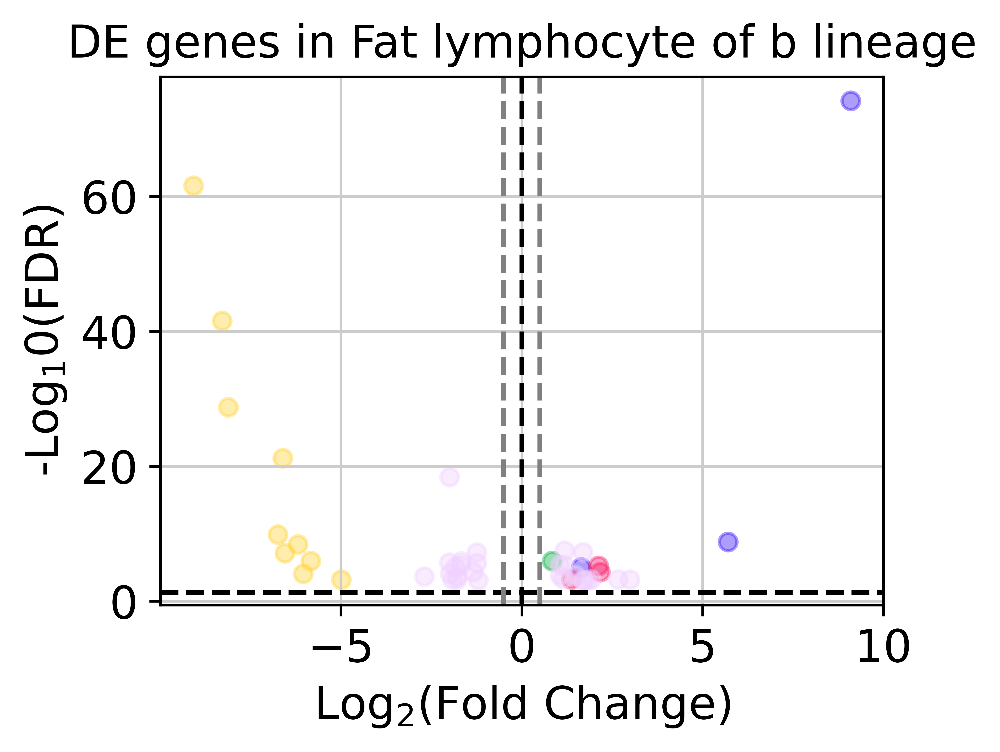

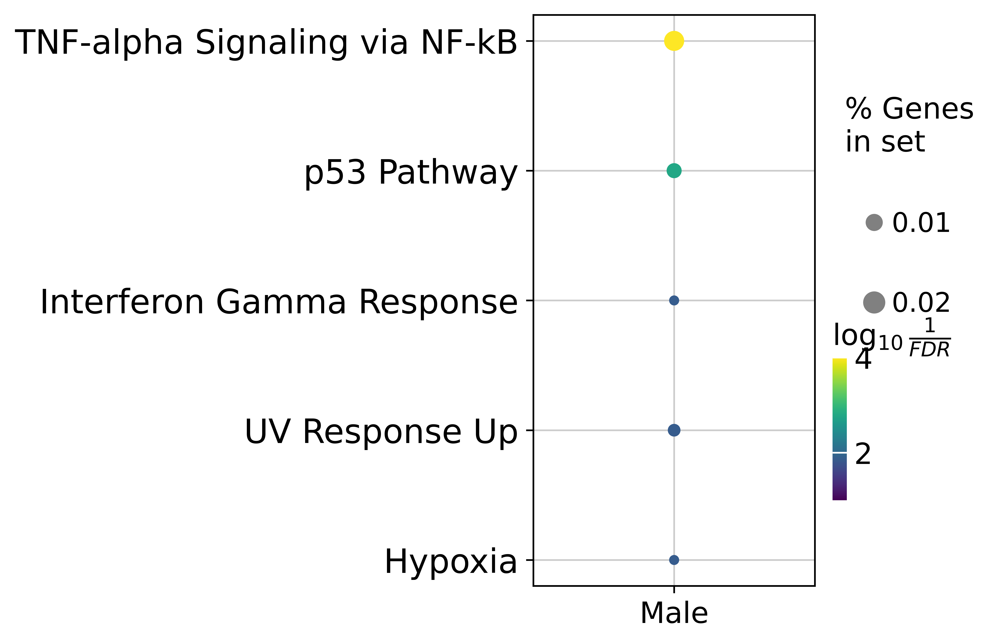

In [148]:
temp,enr_res1,enr_res2 = plot_vocalno(tissue = 'Fat', 
             cell_type = ['lymphocyte of b lineage'], 
             title = 'DE genes in Fat lymphocyte of b lineage',
                                      thr=0.5,
                                      s=30,
                                      s1=20,
                                      s2=80,
                                      title1='supp8_panelD4.pdf',
                                     title2='supp8_panelD5.pdf',
                                     title3='supp8_panelD6.pdf',
                                     )

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/tmp/ipykernel_382353/831361764.py:113: UserWarning: FixedFormatter should only be used together with FixedLocator
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/en

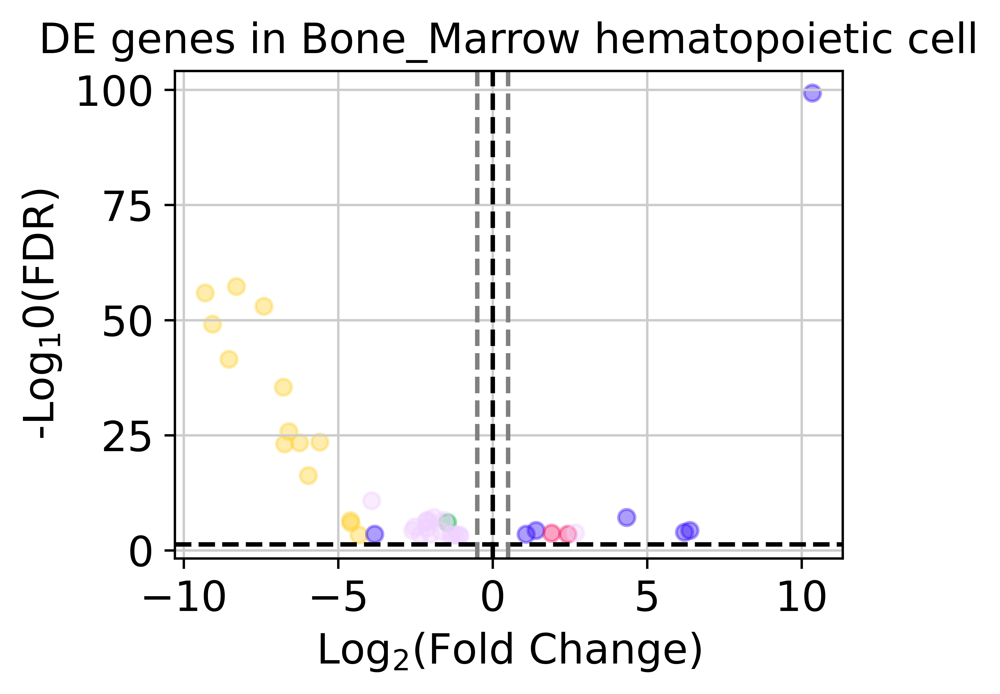

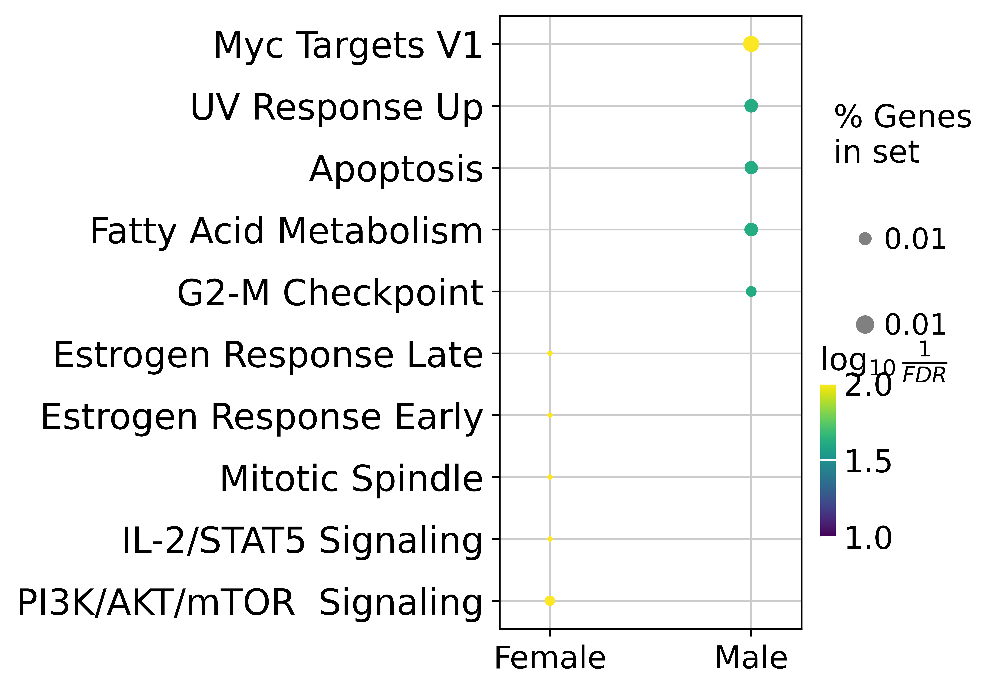

In [149]:
sc.set_figure_params(dpi=600, color_map="viridis_r")
temp,enr_res1,enr_res2 = plot_vocalno(tissue = 'Bone_Marrow', 
             cell_type = ['hematopoietic cell'], 
             title = 'DE genes in Bone_Marrow hematopoietic cell',
                                      thr=0.5,
                                      s=30,
                                      s1=20,
                                      s2=80,
                                      title1='supp8_panelD1.pdf',
                                     title2='supp8_panelD2.pdf',
                                     title3='supp8_panelD3.pdf',
                                     )

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/tmp/ipykernel_382353/831361764.py:113: UserWarning: FixedFormatter should only be used together with FixedLocator
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/en

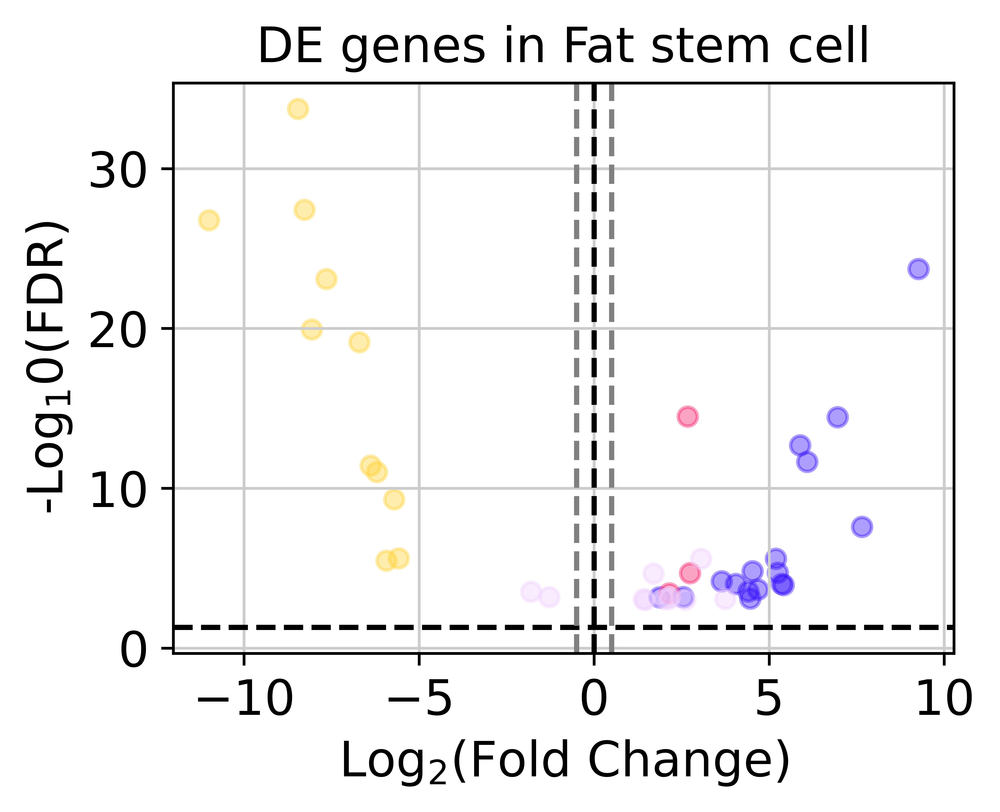

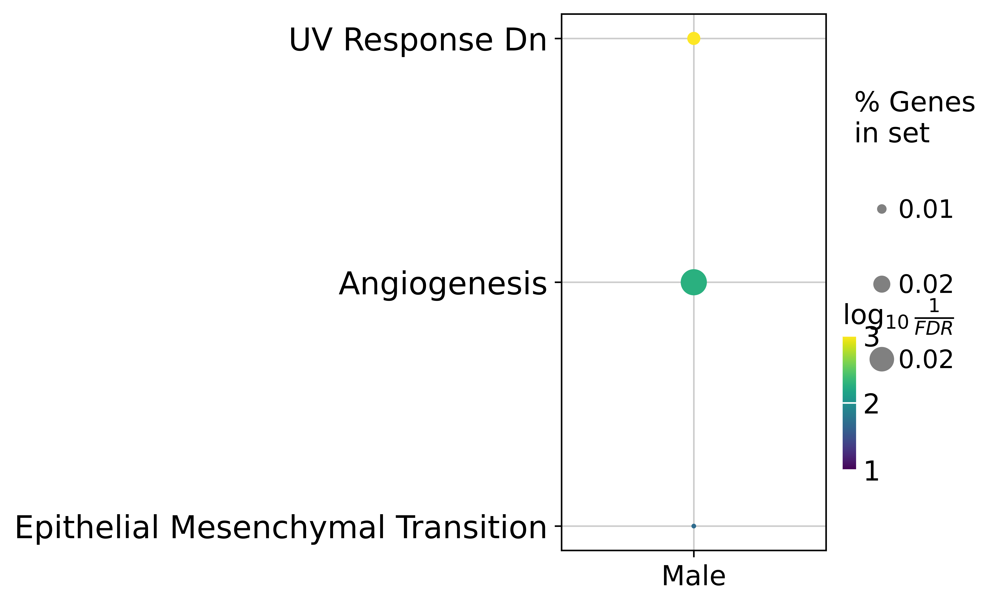

In [150]:
temp,enr_res1,enr_res2 = plot_vocalno(tissue = 'Fat', 
             cell_type = ['stem cell'], 
             title = 'DE genes in Fat stem cell',
                                      thr=0.5,
                                      s=30,
                                      s1=20,
                                      s2=80,
                                      title1='supp8_panelD7.pdf',
                                     title2='supp8_panelD8.pdf',
                                     title3='supp8_panelD9.pdf',
                                     )

In [147]:
TS_data_df['cell_type'].unique()

array(['t cell', 'transitional epithelial cell', 'fibroblast',
       'myeloid leukocyte', 'contractile cell', 'granulocyte',
       'innate lymphoid cell', 'lymphocyte of b lineage',
       'erythroid lineage cell', 'stem cell', 'hematopoietic cell',
       'cardiac endothelial cell', 'endothelial cell', 'epithelial cell',
       'stratified epithelial cell'], dtype=object)

In [71]:
cell_type2_map = {
    't cell':'t cell', 
    'transitional epithelial cell':'epithelial cell', 
    'fibroblast':'fibroblast',
    'myeloid leukocyte':'myeloid leukocyte', 
    'contractile cell':'contractile cell',
    'granulocyte':'granulocyte',
    'endothelial cell':'endothelial cell', 
    'innate lymphoid cell':'innate lymphoid cell', 
    'lymphocyte of b lineage':'lymphocyte of b lineage',
    'hematopoietic cell':'hematopoietic cell',
    
    'erythroid lineage cell':'erythroid lineage cell',
    'stem cell':'stem cell', 
    'cardiac endothelial cell':'endothelial cell',
    'stromal cell': 'epithelial cell',
    'epithelial cell':'epithelial cell',
    'secretory cell':'secretory cell',
    
       'intestinal epithelial cell':'epithelial cell', 
    
       'glandular epithelial cell':'epithelial cell', 
    'ciliated epithelial cell':'epithelial cell',
       'duct epithelial cell':'epithelial cell', 
    'stratified epithelial cell':'epithelial cell'
}

In [72]:
TS_data_df['cell_type2'] = TS_data_df['cell_type'].map(cell_type2_map)

In [73]:
import gseapy as gp
all_libraries = [
    'GO_Biological_Process_2023',
    'GO_Cellular_Component_2023',
    'GO_Molecular_Function_2023',
    'Human_Phenotype_Ontology',
    'KEGG_2021_Human',
    'Reactome_2022',
    'WikiPathway_2023_Human',
    'MSigDB_Hallmark_2020',
    'MSigDB_Oncogenic_Signatures'
]

def gene_ontology(cell_type, title ,thr=1,top_gene = 60,s=20,s1=60,s2=50):
    
    temp = TS_data_df[TS_data_df['cell_type2'].isin([cell_type])]
    
    degs_up = temp[temp['type_new2']=='Autosomal-coding'][temp[temp['type_new2']=='Autosomal-coding'].logFC > thr]
    degs_dw = temp[temp['type_new2']=='Autosomal-coding'][temp[temp['type_new2']=='Autosomal-coding'].logFC < -thr]
    if len(list(degs_up.index))>0:
        enr_up = gp.enrichr(list(degs_up.index),
                            gene_sets='GO_Biological_Process_2023',
                            outdir=None)
        enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
        enr_up.res2d['UP_DW'] = "Female"
        
    if len(list(degs_dw.index))>0:
        enr_dw = gp.enrichr(list(degs_dw.index),
                            gene_sets='GO_Biological_Process_2023',
                            outdir=None)
        enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
        
        enr_dw.res2d['UP_DW'] = "Male"
        
    if (len(list(degs_up.index))>0)&(len(list(degs_dw.index))>0):
        enr_res1 = pd.concat([enr_up.res2d.head(), enr_dw.res2d.head()])
    elif len(list(degs_up.index))==0:
        enr_res1 = enr_dw.res2d.head()
    else:
        enr_res1 = degs_up.res2d.head()
        
    
    if len(list(degs_up.index))>0:
        enr_up = gp.enrichr(list(degs_up.index),
                            gene_sets='MSigDB_Hallmark_2020',
                            outdir=None)
        enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]
        enr_up.res2d['UP_DW'] = "Female"
    
    if len(list(degs_dw.index))>0:
        enr_dw = gp.enrichr(list(degs_dw.index),
                            gene_sets='MSigDB_Hallmark_2020',
                            outdir=None)
        enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]

        enr_dw.res2d['UP_DW'] = "Male"
    if (len(list(degs_up.index))>0)&(len(list(degs_dw.index))>0):
        enr_res2 = pd.concat([enr_up.res2d.head(), enr_dw.res2d.head()])
    elif len(list(degs_up.index))==0:
        enr_res2 = enr_dw.res2d.head()
    else:
        enr_res2 = degs_up.res2d.head()
        

    return temp,enr_res1,enr_res2

In [74]:
GO_all = pd.DataFrame()
KEGG_all = pd.DataFrame()
for ct in TS_data_df['cell_type2'].unique():
    print(ct)
    temp,enr_res1,enr_res2 = gene_ontology(ct, ct ,thr=0.5,top_gene = 60,s=20,s1=60,s2=50)
    enr_res1['tissue'] = ct
    enr_res2['tissue'] = ct
    GO_all = pd.concat([GO_all, enr_res1])
    KEGG_all = pd.concat([KEGG_all, enr_res2])
    

t cell
epithelial cell
fibroblast
myeloid leukocyte
contractile cell
granulocyte
innate lymphoid cell
lymphocyte of b lineage
erythroid lineage cell
stem cell
hematopoietic cell
endothelial cell


In [75]:
color_map = {
    
 'adventitial cell': '#b5cf6b',
 'cardiac endothelial cell': '#393b79',
 'ciliated epithelial cell': '#e377c2',
 'conjunctival epithelial cell': '#e7cb94',
 'connective tissue cell': '#843c39',
 'contractile cell': '#98df8a',
 'dendritic cell': '#9edae5',
 'duct epithelial cell': '#9c9ede',
 'ecto-epithelial cell': '#bd9e39',
 'endo-epithelial cell': '#8c564b',
 'endothelial cell': '#d62728',
 'epithelial cell': '#7f7f7f',
 'epithelial cell of lung': '#8ca252',
 'erythroid lineage cell': '#ff9896',
 'fibroblast': '#ffbb78',
 'glandular epithelial cell': '#dbdb8d',
 'glial cell': '#6b6ecf',
 'granulocyte': '#ff7f0e',
 'hematopoietic cell': '#c7c7c7',
 'hepatocyte': '#d6616b',
 'innate lymphoid cell': '#9467bd',
 'intestinal epithelial cell': '#bcbd22',
 'lymphocyte of b lineage': '#c5b0d5',
 'melanocyte': '#637939',
 'meso-epithelial cell': '#c49c94',
 'myeloid leukocyte': '#1f77b4',
 'neuron': '#8c6d31',
 'retinal pigment epithelial cell': '#a55194',
 'secretory cell': '#f7b6d2',
 'stem cell': '#aec7e8',
 'stratified epithelial cell': '#ad494a',
 'stromal cell': '#5254a3',
 't cell': '#2ca02c',
 'transitional epithelial cell': '#17becf'}



In [76]:
import random
def random_color():
    return "#{:06x}".format(random.randint(0, 0xFFFFFF))


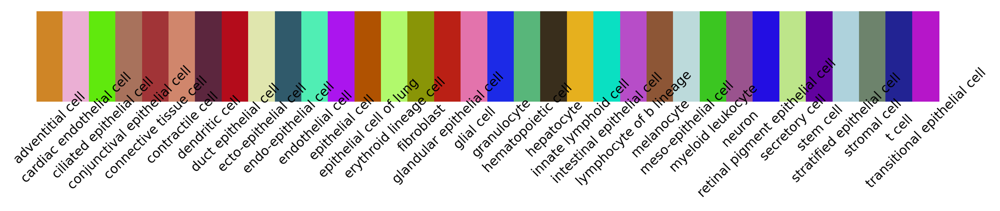

In [77]:
color_map2 = {cluster: random_color() for cluster in color_map}
# Plot the colors
fig, ax = plt.subplots(figsize=(10, 2),dpi=300)
for i, (label, color) in enumerate(color_map2.items()):
    ax.add_patch(plt.Rectangle((i, 0), 1, 1, color=color))
    ax.text(i + 0.5, -0.3, label, ha='center', va='center', rotation=45, fontsize=8)

ax.set_xlim(0, len(color_map))
ax.set_ylim(-1, 1)
ax.axis('off')
plt.show()


In [78]:
cell_type_order = list(TS_data_df['cell_type2'].unique())

In [82]:
# Initialize the cluster_representatives dictionary
cluster_representatives = {}

# Iterate over each unique cluster ID
for cluster_id in np.unique(clusters):
    # Get the indices of terms that belong to the current cluster
    cluster_indices = np.where(clusters == cluster_id)[0]
    
    # Extract the distance matrix for terms within the current cluster
    cluster_distance_matrix = distance_matrix[np.ix_(cluster_indices, cluster_indices)]
    
    # Compute the average distance from each term to all other terms in the cluster
    mean_distances = cluster_distance_matrix.mean(axis=1)
    
    # Find the index of the term with the smallest average distance (most central term)
    representative_index = cluster_indices[np.argmin(mean_distances)]
    
    # Get the representative term for this cluster
    representative_term = GO_all_.iloc[representative_index]['Term']
    
    # Add the representative term to the dictionary with the cluster ID as the key
    cluster_representatives[cluster_id] = representative_term


In [83]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn.manifold import MDS
from networkx.algorithms import bipartite
GO_all_ = pd.concat([GO_all,KEGG_all])
GO_all_['node_size'] = -np.log(GO_all_['Adjusted P-value'])
GO_all_['Term_2'] = GO_all_['Term'] + '_'+GO_all_['tissue']+'_'+GO_all_['UP_DW']
GO_all_=GO_all_[GO_all_['UP_DW']=='Female']
GO_all_.index = list(range(GO_all_.shape[0]))


# Set pandas to display full text for long strings
pd.set_option('display.max_colwidth', None)

# Assume GO_all_['Term'] has your terms
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(GO_all_['Term'])

# Compute cosine similarity matrix
similarity_matrix = cosine_similarity(tfidf_matrix)

# Convert similarity matrix to distance matrix (1 - similarity)
distance_matrix = 1 - similarity_matrix

# Perform hierarchical clustering (Ward's method minimizes variance within clusters)
Z = linkage(distance_matrix, method='ward')

# Assign clusters with a chosen distance threshold (you can adjust the threshold)
clusters = fcluster(Z, t=2.5, criterion='distance')

# Add clusters to the dataframe
GO_all_['cluster'] = clusters

# Summarize the major terms in each cluster
# Initialize an empty dictionary to store representative terms for each cluster
cluster_components = {}

# Iterate over each cluster
for cluster_id in np.unique(clusters):
    # Get the indices of terms that belong to the current cluster
    cluster_indices = np.where(clusters == cluster_id)[0]
    
    # Get the representative term for this cluster
    representative_term = cluster_representatives[cluster_id]
    
    # Extract the terms (components) and their cell types within this cluster
    components = GO_all_.iloc[cluster_indices][['Term', 'tissue', 'Adjusted P-value']]
    
    # Store the components for the representative term
    cluster_components[representative_term] = components

# Convert the cluster_components dictionary into a DataFrame for easier plotting
cluster_summary = pd.concat(cluster_components, names=['Representative_Term'])
cluster_summary.reset_index(level=0, inplace=True)
cluster_summary['color'] = cluster_summary['tissue'].map(color_map)

# Adjust dot size based on the negative log of the adjusted p-value
cluster_summary['size'] = -np.log(cluster_summary['Adjusted P-value'])

tissue_categories = cell_type_order  # Your desired tissue order
tissue_to_num = {tissue: idx for idx, tissue in enumerate(tissue_categories)}

mean_cluster_summary = cluster_summary.groupby(['tissue', 'Representative_Term']).agg({
    'size': 'mean',
    'color': 'first'  # Keep the color for each group
}).reset_index()

# Group by 'tissue' and 'Representative_Term' and calculate the mean size for each group
mean_cluster_summary['tissue_num'] = mean_cluster_summary['tissue'].map(tissue_to_num)

# Plot the results with dot size based on the adjusted p-value


# Adjust dot size based on the negative log of the adjusted p-value
cluster_summary['size'] = -np.log(cluster_summary['Adjusted P-value'])

mean_cluster_summary['tissue'] = pd.Categorical(mean_cluster_summary['tissue'], categories=cell_type_order, ordered=True)

# Map tissues to numerical positions
tissue_to_num = {tissue: idx for idx, tissue in enumerate(cell_type_order)}
mean_cluster_summary['tissue_num'] = mean_cluster_summary['tissue'].map(tissue_to_num)

# Sort the DataFrame by 'Representative_Term' and 'tissue_num' to preserve order
mean_cluster_summary.sort_values(['Representative_Term', 'tissue_num'], inplace=True)


GO_all_female = mean_cluster_summary

In [84]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn.manifold import MDS
from networkx.algorithms import bipartite
GO_all_ = pd.concat([GO_all,KEGG_all])
GO_all_['node_size'] = -np.log(GO_all_['Adjusted P-value'])
GO_all_['Term_2'] = GO_all_['Term'] + '_'+GO_all_['tissue']+'_'+GO_all_['UP_DW']
GO_all_=GO_all_[GO_all_['UP_DW']=='Male']
GO_all_.index = list(range(GO_all_.shape[0]))


# Set pandas to display full text for long strings
pd.set_option('display.max_colwidth', None)

# Assume GO_all_['Term'] has your terms
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(GO_all_['Term'])

# Compute cosine similarity matrix
similarity_matrix = cosine_similarity(tfidf_matrix)

# Convert similarity matrix to distance matrix (1 - similarity)
distance_matrix = 1 - similarity_matrix

# Perform hierarchical clustering (Ward's method minimizes variance within clusters)
Z = linkage(distance_matrix, method='ward')

# Assign clusters with a chosen distance threshold (you can adjust the threshold)
clusters = fcluster(Z, t=2.5, criterion='distance')

# Add clusters to the dataframe
GO_all_['cluster'] = clusters

# Summarize the major terms in each cluster
# Initialize an empty dictionary to store representative terms for each cluster
cluster_components = {}

# Iterate over each cluster
for cluster_id in np.unique(clusters):
    # Get the indices of terms that belong to the current cluster
    cluster_indices = np.where(clusters == cluster_id)[0]
    
    # Get the representative term for this cluster
    representative_term = cluster_representatives[cluster_id]
    
    # Extract the terms (components) and their cell types within this cluster
    components = GO_all_.iloc[cluster_indices][['Term', 'tissue', 'Adjusted P-value']]
    
    # Store the components for the representative term
    cluster_components[representative_term] = components

# Convert the cluster_components dictionary into a DataFrame for easier plotting
cluster_summary = pd.concat(cluster_components, names=['Representative_Term'])
cluster_summary.reset_index(level=0, inplace=True)
cluster_summary['color'] = cluster_summary['tissue'].map(color_map)

# Adjust dot size based on the negative log of the adjusted p-value
cluster_summary['size'] = -np.log(cluster_summary['Adjusted P-value'])

tissue_categories = cell_type_order  # Your desired tissue order
tissue_to_num = {tissue: idx for idx, tissue in enumerate(tissue_categories)}

mean_cluster_summary = cluster_summary.groupby(['tissue', 'Representative_Term']).agg({
    'size': 'mean',
    'color': 'first'  # Keep the color for each group
}).reset_index()

# Group by 'tissue' and 'Representative_Term' and calculate the mean size for each group
mean_cluster_summary['tissue_num'] = mean_cluster_summary['tissue'].map(tissue_to_num)

# Plot the results with dot size based on the adjusted p-value


# Adjust dot size based on the negative log of the adjusted p-value
cluster_summary['size'] = -np.log(cluster_summary['Adjusted P-value'])

mean_cluster_summary['tissue'] = pd.Categorical(mean_cluster_summary['tissue'], categories=cell_type_order, ordered=True)

# Map tissues to numerical positions
tissue_to_num = {tissue: idx for idx, tissue in enumerate(cell_type_order)}
mean_cluster_summary['tissue_num'] = mean_cluster_summary['tissue'].map(tissue_to_num)

# Sort the DataFrame by 'Representative_Term' and 'tissue_num' to preserve order
mean_cluster_summary.sort_values(['Representative_Term', 'tissue_num'], inplace=True)


GO_all_male = mean_cluster_summary

In [85]:
GO_all_male

,tissue,Representative_Term,size,color,tissue_num
15,epithelial cell,Androgen Response,6.046084,#7f7f7f,1
70,myeloid leukocyte,Androgen Response,15.599052,#1f77b4,3
80,stem cell,Androgen Response,1.113005,#aec7e8,9
45,hematopoietic cell,Androgen Response,27.575314,#c7c7c7,10
16,epithelial cell,Apical Junction,4.051385,#7f7f7f,1
...,...,...,...,...,...
61,innate lymphoid cell,mTORC1 Signaling,7.779366,#9467bd,6
69,lymphocyte of b lineage,mTORC1 Signaling,4.760461,#c5b0d5,7
22,epithelial cell,p53 Pathway,16.455914,#7f7f7f,1
7,contractile cell,p53 Pathway,3.426096,#98df8a,4


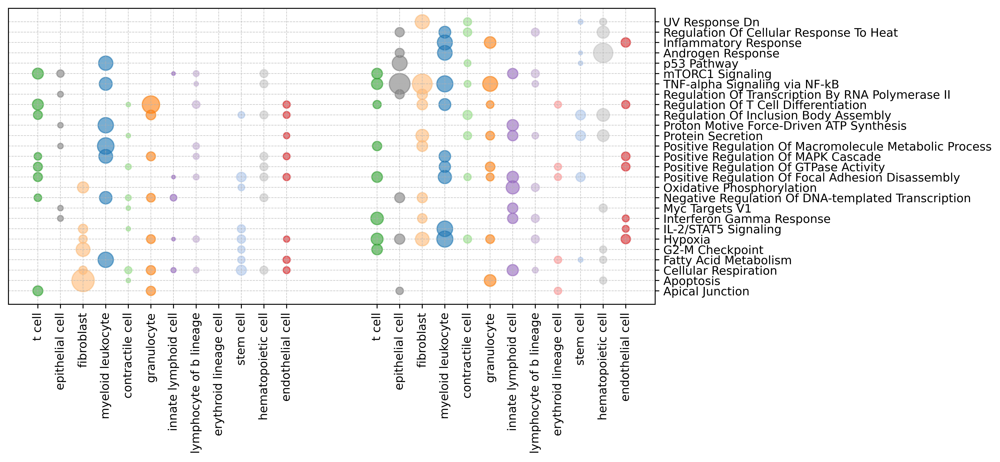

In [121]:
unified_terms = pd.concat([GO_all_female['Representative_Term'], GO_all_male['Representative_Term']]).unique()

# Apply the unified order to both male and female datasets
GO_all_female['Representative_Term'] = pd.Categorical(
    GO_all_female['Representative_Term'], categories=unified_terms, ordered=True
)
GO_all_male['Representative_Term'] = pd.Categorical(
    GO_all_male['Representative_Term'], categories=unified_terms, ordered=True
)

GO_all_female = GO_all_female.sort_values('Representative_Term')
GO_all_male = GO_all_male.sort_values('Representative_Term')


# Plotting for Female
plt.figure(figsize=(12, 5.6), dpi=800)
offset = 15

for idx, row in GO_all_female.iterrows():
    plt.scatter(row['tissue_num'], row['Representative_Term'], 
                s=row['size'] * 10, alpha=0.6, 
                c=row['color'])

for idx, row in GO_all_male.iterrows():
    plt.scatter(row['tissue_num']+offset, row['Representative_Term'], 
                s=row['size'] * 10, alpha=0.6, 
                c=row['color'])
female_xticks = range(len(cell_type_order))
male_xticks = range(offset, offset + len(cell_type_order))

plt.xticks(
    list(female_xticks) + list(male_xticks),
    list(cell_type_order) + list(cell_type_order),
    rotation=90
)

plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.7)
plt.gca().yaxis.set_ticks_position('right')
#plt.title('Male Representative Terms')
plt.tight_layout()
plt.savefig('panelF.pdf',dpi=800,format='pdf')


In [ ]:
# Plot the results
plt.figure(figsize=(9, 9), dpi=800)

# Iterate over each row in the sorted DataFrame to plot the bubbles
for idx, row in mean_cluster_summary.iterrows():
    plt.scatter(row['tissue_num'], row['Representative_Term'], 
                s=row['size'] * 10, alpha=0.6, 
                c=row['color'])
# Add labels and title
#plt.xlabel('Cell Type (Tissue)')
#plt.ylabel('Representative Term')
#plt.title('Cell Type Components for Each Representative Term')
plt.xticks(range(len(cell_type_order)), cell_type_order, rotation=90)

plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.7)

# Optional: Adjust y-axis ticks
#plt.yticks([])  # Remove y-axis ticks if you don't want to display them
#plt.gca().set_yticklabels([])
#plt.gca().set_xticklabels([])
plt.gca().yaxis.set_ticks_position('right')  # Move y-axis ticks to the right

plt.tight_layout()

# Show plot
plt.show()



,tissue,Representative_Term,size,color,tissue_num
71,t cell,Apical Junction,7.217013,#2ca02c,0
28,granulocyte,Apical Junction,6.189033,#ff7f0e,5
22,fibroblast,Apoptosis,36.464288,#ffbb78,2
0,contractile cell,Apoptosis,1.485417,#98df8a,4
23,fibroblast,Cellular Respiration,4.993742,#ffbb78,2
...,...,...,...,...,...
21,epithelial cell,mTORC1 Signaling,3.953248,#7f7f7f,1
47,innate lymphoid cell,mTORC1 Signaling,0.941799,#9467bd,6
55,lymphocyte of b lineage,mTORC1 Signaling,2.527752,#c5b0d5,7
42,hematopoietic cell,mTORC1 Signaling,4.605180,#c7c7c7,10


In [159]:
cluster_summary[cluster_summary.Representative_Term=='Positive Regulation Of Vascular Associated Smooth Muscle Cell Migration']

,Representative_Term,Term,tissue,Adjusted P-value,color,size


In [208]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn.manifold import MDS
GO_all_ = pd.concat([GO_all,KEGG_all])
GO_all_['node_size'] = -np.log(GO_all_['Adjusted P-value'])
GO_all_['Term_2'] = GO_all_['Term'] + '_'+GO_all_['tissue']+'_'+GO_all_['UP_DW']
GO_all_=GO_all_[GO_all_['UP_DW']=='Male']
GO_all_.index = list(range(GO_all_.shape[0]))
# Define color map based on the 'UP_DW' attribute
#color_map = {'Male': '#1f77b4', 'Female': '#d62728'}

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from scipy.cluster.hierarchy import linkage, fcluster
import numpy as np
import pandas as pd

# Set pandas to display full text for long strings
pd.set_option('display.max_colwidth', None)

# Assume GO_all_['Term'] has your terms
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(GO_all_['Term'])

# Compute cosine similarity matrix
similarity_matrix = cosine_similarity(tfidf_matrix)

# Convert similarity matrix to distance matrix (1 - similarity)
distance_matrix = 1 - similarity_matrix

# Perform hierarchical clustering (Ward's method minimizes variance within clusters)
Z = linkage(distance_matrix, method='ward')

# Assign clusters with a chosen distance threshold (you can adjust the threshold)
clusters = fcluster(Z, t=2.5, criterion='distance')

# Add clusters to the dataframe
GO_all_['cluster'] = clusters

# Summarize the major terms in each cluster
# Initialize an empty dictionary to store representative terms for each cluster
cluster_components = {}

# Iterate over each cluster
for cluster_id in np.unique(clusters):
    # Get the indices of terms that belong to the current cluster
    cluster_indices = np.where(clusters == cluster_id)[0]
    
    # Get the representative term for this cluster
    representative_term = cluster_representatives[cluster_id]
    
    # Extract the terms (components) and their cell types within this cluster
    components = GO_all_.iloc[cluster_indices][['Term', 'tissue', 'Adjusted P-value']]
    
    # Store the components for the representative term
    cluster_components[representative_term] = components


# Convert the cluster_components dictionary into a DataFrame for easier plotting
cluster_summary = pd.concat(cluster_components, names=['Representative_Term'])
cluster_summary.reset_index(level=0, inplace=True)
cluster_summary['color'] = cluster_summary['tissue'].map(color_map)

# Adjust dot size based on the negative log of the adjusted p-value
cluster_summary['size'] = -np.log(cluster_summary['Adjusted P-value'])

tissue_categories = cell_type_order  # Your desired tissue order
tissue_to_num = {tissue: idx for idx, tissue in enumerate(tissue_categories)}

mean_cluster_summary = cluster_summary.groupby(['tissue', 'Representative_Term']).agg({
    'size': 'mean',
    'color': 'first'  # Keep the color for each group
}).reset_index()

# Group by 'tissue' and 'Representative_Term' and calculate the mean size for each group
mean_cluster_summary['tissue_num'] = mean_cluster_summary['tissue'].map(tissue_to_num)

# Plot the results with dot size based on the adjusted p-value


# Adjust dot size based on the negative log of the adjusted p-value
cluster_summary['size'] = -np.log(cluster_summary['Adjusted P-value'])

mean_cluster_summary['tissue'] = pd.Categorical(mean_cluster_summary['tissue'], categories=cell_type_order, ordered=True)

# Map tissues to numerical positions
tissue_to_num = {tissue: idx for idx, tissue in enumerate(cell_type_order)}
mean_cluster_summary['tissue_num'] = mean_cluster_summary['tissue'].map(tissue_to_num)

# Sort the DataFrame by 'Representative_Term' and 'tissue_num' to preserve order
mean_cluster_summary.sort_values(['Representative_Term', 'tissue_num'], inplace=True)

# Plot the results
plt.figure(figsize=(9,9), dpi=800)

# Iterate over each row in the sorted DataFrame to plot the bubbles
for idx, row in mean_cluster_summary.iterrows():
    plt.scatter(row['tissue_num'], row['Representative_Term'], 
                s=row['size'] * 10, alpha=0.6, 
                c=row['color'])
# Add labels and title
#plt.xlabel('Cell Type (Tissue)')
#plt.ylabel('Representative Term')
#plt.title('Cell Type Components for Each Representative Term')
plt.xticks(range(len(cell_type_order)), cell_type_order, rotation=90)

plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.7)
#plt.gca().set_yticklabels([])
#plt.gca().set_xticklabels([])
#plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small')
plt.tight_layout()
plt.gca().yaxis.set_ticks_position('right')
# Show plot
plt.show()

In [161]:
cluster_representatives

{1: 'Hypoxia',
 2: 'Negative Regulation Of Inclusion Body Assembly',
 3: 'Regulation Of Transcription By RNA Polymerase II',
 4: 'Negative Regulation Of DNA-templated Transcription',
 5: 'Regulation Of T Cell Differentiation',
 6: 'Positive Regulation Of Macromolecule Metabolic Process',
 7: 'Positive Regulation Of GTPase Activity',
 8: 'Positive Regulation Of MAPK Cascade',
 9: 'Positive Regulation Of Focal Adhesion Disassembly',
 10: 'TNF-alpha Signaling via NF-kB',
 11: 'mTORC1 Signaling',
 12: 'IL-2/STAT5 Signaling',
 13: 'p53 Pathway',
 14: 'Oxidative Phosphorylation',
 15: 'Fatty Acid Metabolism',
 16: 'G2-M Checkpoint',
 17: 'Apical Junction',
 18: 'Apoptosis',
 19: 'Myc Targets V1',
 20: 'Proton Motive Force-Driven ATP Synthesis',
 21: 'Protein Secretion',
 22: 'Interferon Gamma Response',
 23: 'Cellular Respiration',
 24: 'Regulation Of Cellular Response To Heat',
 25: 'UV Response Dn',
 26: 'Inflammatory Response',
 27: 'Androgen Response'}

In [162]:
mean_cluster_summary[mean_cluster_summary.Representative_Term=='Positive Regulation Of Vascular Associated Smooth Muscle Cell Migration']

,tissue,Representative_Term,size,color,tissue_num


In [163]:
unique_clusters = list(set(clusters))
cluster_colors = {cluster: random_color() for cluster in unique_clusters}

# Get node colors based on cluster
node_cluster_colors = [cluster_colors[G.nodes[node]['cluster']] for node in G.nodes]
node_colors = [color_map[G.nodes[node]['tissue']] for node in G.nodes]


# Function to initialize node positions based on clusters
def initial_cluster_positions(G, cluster_attr='cluster', scale=1.0):
    pos = {}
    cluster_centers = {}
    cluster_count = {}
    unique_clusters = list(set(nx.get_node_attributes(G, cluster_attr).values()))
    grid_size = int(np.ceil(np.sqrt(len(unique_clusters))))

    for i, cluster in enumerate(unique_clusters):
        x = (i % grid_size) * scale
        y = (i // grid_size) * scale
        cluster_centers[cluster] = (x, y)
        cluster_count[cluster] = 0

    for node in G.nodes():
        cluster = G.nodes[node][cluster_attr]
        pos[node] = (cluster_centers[cluster][0] + 0.1 * cluster_count[cluster],
                     cluster_centers[cluster][1] + 0.1 * cluster_count[cluster])
        cluster_count[cluster] += 1
    
    return pos

# Initialize positions
initial_pos = initial_cluster_positions(G, scale=5)

# Refine positions with spring layout
pos = nx.spring_layout(G, pos=initial_pos, k=0.3, iterations=1, seed=111)

# Draw the network with clusters
plt.figure(figsize=(10,8), dpi=500)
node_sizes = [G.nodes[node]['size']  for node in G.nodes]
edge_widths = [G[u][v]['weight'] for u, v in G.edges]

nx.draw(G, pos, with_labels=True, font_size=3, node_color=node_cluster_colors, node_size=node_sizes, edge_color='lightgray', width=edge_widths, alpha=0.8)
plt.axis('off')  # Hide the axis
plt.show()

NameError: name 'G' is not defined